In [2]:
import pandas as pd
import numpy as np
from scipy import stats
from statsmodels.graphics.gofplots import qqplot
import statsmodels.formula.api as smf
import matplotlib.pyplot as plt
import seaborn as sns
import plotly.express as px

import transform as tf

df = pd.read_csv('./loan_payments.csv')

# rename columns before casting to numerical datatype:
df = df.rename(columns = {'term': 'term_months', 'employment_length': 'employment_length_years'})

# Columns whose datatypes need changing:
date_cols = ['issue_date', 'earliest_credit_line','last_payment_date', 'next_payment_date', 'last_credit_pull_date']
int_cols = ['mths_since_last_record', 'collections_12_mths_ex_med', 'mths_since_last_major_derog']
bool_cols = ['payment_plan']
str_cols = ['grade', 'sub_grade', 'home_ownership', 'verification_status', 'loan_status', 'purpose' ,'application_type']
str_to_int_cols = ['term_months', 'employment_length_years']

# Change identified columns' datatypes:
dt = tf.DataTransform(df) 
dt.transform_date(date_cols)
dt.transform_int(int_cols)
dt.transform_bool(bool_cols)
dt.transform_str(str_cols)

# Quick test actioned:
print(dt.df['issue_date'].head())
print(dt.df['earliest_credit_line'].head())
print(dt.df['collections_12_mths_ex_med'].head())
print(dt.df['mths_since_last_record'].tail())
print(dt.df['payment_plan'].head())
print(type(dt.df['sub_grade'][4]))

0   2021-01-01
1   2021-01-01
2   2021-01-01
3   2021-01-01
4   2021-01-01
Name: issue_date, dtype: datetime64[ns]
0   1987-10-01
1   2001-09-01
2   1998-09-01
3   2008-06-01
4   2002-04-01
Name: earliest_credit_line, dtype: datetime64[ns]
0    0.0
1    0.0
2    0.0
3    0.0
4    0.0
Name: collections_12_mths_ex_med, dtype: float64
54226    NaN
54227    0.0
54228    NaN
54229    0.0
54230    NaN
Name: mths_since_last_record, dtype: float64
0    False
1    False
2    False
3    False
4    False
Name: payment_plan, dtype: bool
<class 'str'>


In [3]:
# Replace values that mean the same thing and remove symbols:
values_to_replace = {'loan_status':
                     {'Source Verified': 'Verified',
                      'Does not meet the credit policy. Status:Fully Paid': 'Fully Paid',
                      'Does not meet the credit policy. Status:Charged Off':'Charged Off'},
                      'employment_length_years':{
                      '< 1 year': '0',
                      '10+ years': '10'}}


dt.df.replace(values_to_replace, inplace=True)
print(dt.df['loan_status'].unique())
print(dt.df['employment_length_years'].unique())

dt.str_to_int(str_to_int_cols)

print(dt.df['loan_status'].unique())
print(dt.df['employment_length_years'].sort_values().unique())

print(dt.df['term_months'].head())
print(dt.df['employment_length_years'].head())



<StringArray>
[           'Current',         'Fully Paid',        'Charged Off',
 'Late (31-120 days)',    'In Grace Period',  'Late (16-30 days)',
            'Default']
Length: 7, dtype: string
['5 years' '9 years' '8 years' '1 year' '10' '0' nan '7 years' '3 years'
 '4 years' '6 years' '2 years']
<StringArray>
[           'Current',         'Fully Paid',        'Charged Off',
 'Late (31-120 days)',    'In Grace Period',  'Late (16-30 days)',
            'Default']
Length: 7, dtype: string
[ 0.  1.  2.  3.  4.  5.  6.  7.  8.  9. 10. nan]
0    36.0
1    36.0
2    36.0
3    36.0
4    36.0
Name: term_months, dtype: float64
0     5.0
1     9.0
2     8.0
3     1.0
4    10.0
Name: employment_length_years, dtype: float64


In [4]:
dfi = tf.DataFrameInfo(dt.df)
print(dfi.df.dtypes)

id                                      int64
member_id                               int64
loan_amount                             int64
funded_amount                         float64
funded_amount_inv                     float64
term_months                           float64
int_rate                              float64
instalment                            float64
grade                          string[python]
sub_grade                      string[python]
employment_length_years               float64
home_ownership                 string[python]
annual_inc                            float64
verification_status            string[python]
issue_date                     datetime64[ns]
loan_status                    string[python]
payment_plan                             bool
purpose                        string[python]
dti                                   float64
delinq_2yrs                             int64
earliest_credit_line           datetime64[ns]
inq_last_6mths                    

In [5]:

# count nulls to determine whether to drop any columns
cols_with_nulls = dfi.df.columns[dfi.df.isna().any()]
dfi.count_nulls(cols_with_nulls)

funded_amount                         3007           5.54 %
term_months                           4772            8.8 %
int_rate                              5169           9.53 %
employment_length_years               2118           3.91 %
mths_since_last_delinq               31002          57.17 %
mths_since_last_record               48050           88.6 %
last_payment_date                       73           0.13 %
next_payment_date                    32608          60.13 %
last_credit_pull_date                    7           0.01 %
collections_12_mths_ex_med              51           0.09 %
mths_since_last_major_derog          46732          86.17 %


In [6]:
dfi.count_distinct()

Categorical columns:
grade                   7
sub_grade              35
home_ownership          5
verification_status     3
loan_status             7
payment_plan            2
purpose                14
application_type        1
dtype: int64


In [7]:
# Four columns have over 50% nulls, therefore dropping those columns. 
# Also dropping member_id as don't need this for analysis, and application_type and policy_code as all records have the same value.

dfi.df.drop(columns = ['member_id','mths_since_last_delinq','mths_since_last_record','next_payment_date','mths_since_last_major_derog','application_type','policy_code'], axis = 1, inplace=True)
cols_with_nulls = dfi.df.columns[dfi.df.isna().any()]
dfi.count_nulls(cols_with_nulls)

funded_amount                        3007           5.54 %
term_months                          4772            8.8 %
int_rate                             5169           9.53 %
employment_length_years              2118           3.91 %
last_payment_date                      73           0.13 %
last_credit_pull_date                   7           0.01 %
collections_12_mths_ex_med             51           0.09 %


In [8]:
# Drop rows with nulls in columns with low % nulls
rows_with_nulls = ['last_payment_date', 'last_credit_pull_date', 'collections_12_mths_ex_med']
dfi.df = dfi.df.dropna(subset = rows_with_nulls, axis = 0)

cols_with_nulls = dfi.df.columns[dfi.df.isna().any()]
dfi.count_nulls(cols_with_nulls)

funded_amount                     2998           5.54 %
term_months                       4762            8.8 %
int_rate                          5159           9.54 %
employment_length_years           2114           3.91 %


In [9]:
# run normaltest on numerical variables with nulls

dfi.normal_test()


 term_months : Statistics=16696.403, p=0.000

 funded_amount : Statistics=4471.568, p=0.000

 employment_length_years : Statistics=335609.356, p=0.000

 int_rate : Statistics=1417.246, p=0.000


In [10]:
stats = dfi.df_stats(['funded_amount', 'term_months', 'int_rate', 'employment_length_years'])
print(stats)


                    Column          Mean    Median      Mode      Std Dev  \
0            funded_amount  13241.016007  12000.00  10000.00  8017.735444   
0              term_months     42.615104     36.00     36.00    10.724049   
0                 int_rate     13.507936     13.16     11.99     4.393899   
0  employment_length_years      5.695572      6.00     10.00     3.648951   

            Var       Max     Min  
0  6.428408e+07  35000.00  500.00  
0  1.150052e+02     60.00   36.00  
0  1.930634e+01     26.06    5.42  
0  1.331484e+01     10.00    0.00  


### IMPUTE NULL VALUES

skew: -0.11697290135884685


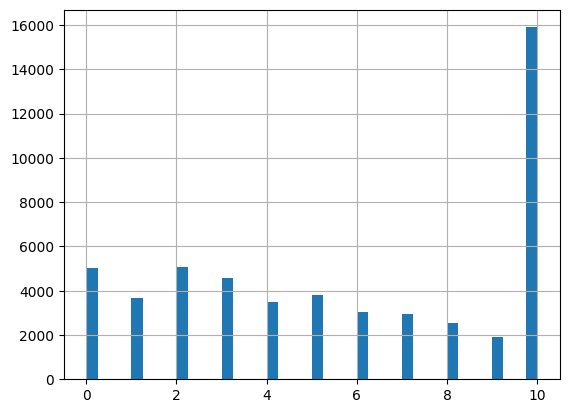

In [11]:
cols_to_impute_median = []
cols_to_impute_mean = []

dfi.df['employment_length_years'].hist(bins=40)   
print(f'skew: {dfi.df["employment_length_years"].skew()}')

In [12]:
#skew very low, so could impute with mean, however column is ordinal categorical data, and mean quite close to median, so impute nulls with median
cols_to_impute_median.extend(['employment_length_years'])

skew: 0.411540039874641


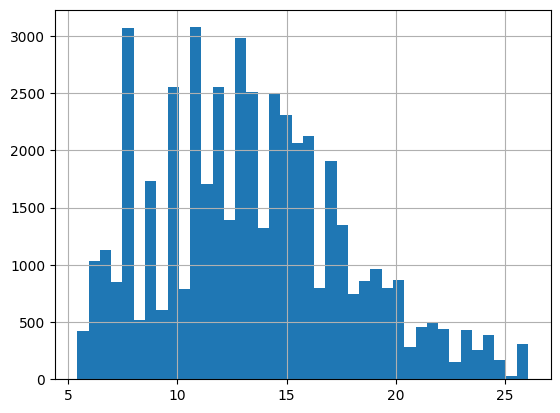

In [13]:
#next look at int_rate:
dfi.df['int_rate'].hist(bins=40)
print(f'skew: {dfi.df["int_rate"].skew()}')

In [14]:
# Interest rate has positive skew, so best to impute with median

cols_to_impute_median.extend(['int_rate'])


skew: 1.004306180537136


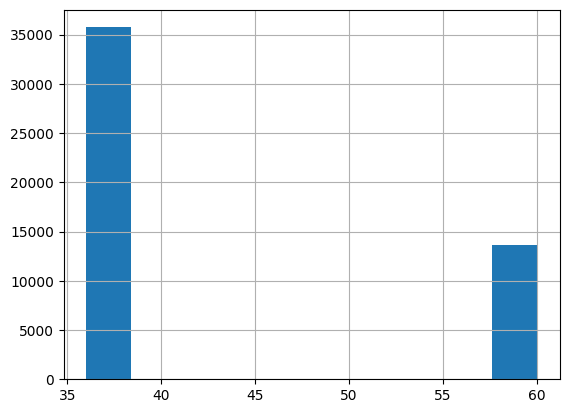

In [15]:
# next look at term_months:
dfi.df['term_months'].hist(bins=10)
print(f'skew: {dfi.df["term_months"].skew()}')

In [16]:
# add to columns to impute with median:
cols_to_impute_median.extend(['term_months'])
print(cols_to_impute_median)

['employment_length_years', 'int_rate', 'term_months']


skew: 0.8208113751273644


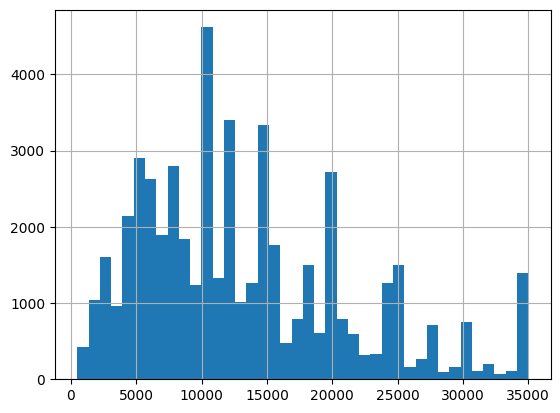

In [17]:
# finally, look at funded_amount:
dfi.df['funded_amount'].hist(bins=40)
print(f'skew: {dfi.df["funded_amount"].skew()}')

In [18]:
# add to columns to impute with median:
cols_to_impute_median.extend(['funded_amount'])

In [19]:
# Impute selected columns with mean and median

dft = tf.DataFrameTransform(dfi.df)
dft.impute_median(cols_to_impute_median)
dft.impute_mean(cols_to_impute_mean)
dft.df.info()


<class 'pandas.core.frame.DataFrame'>
Index: 54100 entries, 0 to 54227
Data columns (total 36 columns):
 #   Column                      Non-Null Count  Dtype         
---  ------                      --------------  -----         
 0   id                          54100 non-null  int64         
 1   loan_amount                 54100 non-null  int64         
 2   funded_amount               54100 non-null  float64       
 3   funded_amount_inv           54100 non-null  float64       
 4   term_months                 54100 non-null  float64       
 5   int_rate                    54100 non-null  float64       
 6   instalment                  54100 non-null  float64       
 7   grade                       54100 non-null  string        
 8   sub_grade                   54100 non-null  string        
 9   employment_length_years     54100 non-null  float64       
 10  home_ownership              54100 non-null  string        
 11  annual_inc                  54100 non-null  float64       


c:\Users\karen\AiCore\15-Project\EDA\exploratory-data-analysis---customer-loans-in-finance883\transform.py:532: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.df[col] = self.df[col].fillna(self.df[col].median())
c:\Users\karen\AiCore\15-Project\EDA\exploratory-data-analysis---customer-loans-in-finance883\transform.py:532: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.df[col] = self.df[col].fillna(self.df[col].median())
c:\Users\karen\AiCore\15-Project\EDA\exploratory-data-analysis---customer-loans-

### Keeping a copy of the df for later

In [20]:

df_no_nulls = dft.df.copy()



### SKEWED COLUMNS

In [21]:
#Identify the skewed columns
num_cols_df = dft.df.select_dtypes(include=[np.number])
num_cols = num_cols_df.columns.tolist()
print('Skew:')
for col in num_cols_df:
    print(f'{col:>30} : {dft.df[col].skew()}')

Skew:
                            id : 2.3694145865064615
                   loan_amount : 0.8043121863503576
                 funded_amount : 0.8691022091141762
             funded_amount_inv : 0.8142509295608985
                   term_months : 1.1463315618353964
                      int_rate : 0.45605544976201656
                    instalment : 0.9961503404396858
       employment_length_years : -0.12923073889522216
                    annual_inc : 8.73573692583551
                           dti : 0.18901977139121579
                   delinq_2yrs : 5.318817917464191
                inq_last_6mths : 3.243836167526465
                 open_accounts : 1.0594931166880517
                total_accounts : 0.7800832932375489
                     out_prncp : 2.352525970614482
                 out_prncp_inv : 2.3529464346145614
                 total_payment : 1.2692662197762663
             total_payment_inv : 1.2584742300393752
               total_rec_prncp : 1.262007269838639
        


Look at columns with skew > 1 or < -1

In [22]:
skewed_cols = []
print('Skew:')
for col in num_cols:
    if (abs(dft.df[col].skew()) > 1) and (col != 'id'):
        skewed_cols.append(col)

print(dft.df[skewed_cols].skew())

Skew:
term_months                    1.146332
annual_inc                     8.735737
delinq_2yrs                    5.318818
inq_last_6mths                 3.243836
open_accounts                  1.059493
out_prncp                      2.352526
out_prncp_inv                  2.352946
total_payment                  1.269266
total_payment_inv              1.258474
total_rec_prncp                1.262007
total_rec_int                  2.203625
total_rec_late_fee            13.258472
recoveries                    14.382675
collection_recovery_fee       27.794716
last_payment_amount            2.496079
collections_12_mths_ex_med    20.298064
dtype: float64


In [23]:
dfi = tf.DataFrameInfo(dft.df)
pl = tf.Plotter(dft.df)

log_transform_cols = []
yeo_transform_cols = []

Skew annual_income

annual_inc    8.735737
dtype: float64


,Column,Mean,Median,Mode,Std Dev,Var,Max,Min
0,annual_inc,72222.855233,61052.5,60000.0,51554.882344,2.657906e+09,2039784.0,3300.0


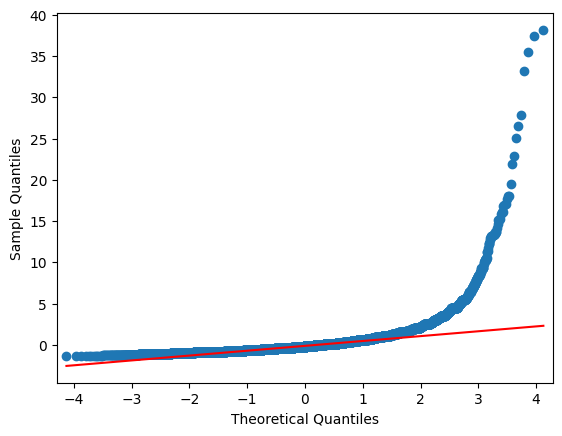

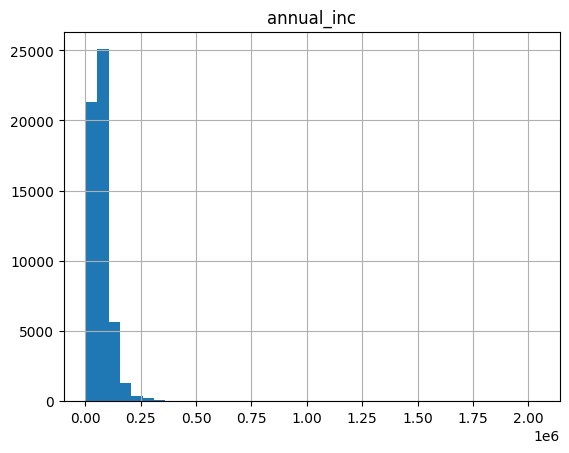

In [24]:
#let's start with annual income

pl.qq_plot('annual_inc')
pl.col_hist(['annual_inc'])
dfi.df_stats(['annual_inc'])

c:\Users\karen\AiCore\15-Project\EDA\exploratory-data-analysis---customer-loans-in-finance883\transform.py:341: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  t=sns.histplot(log_col,label="Skewness: %.2f"%(log_col.skew()) )


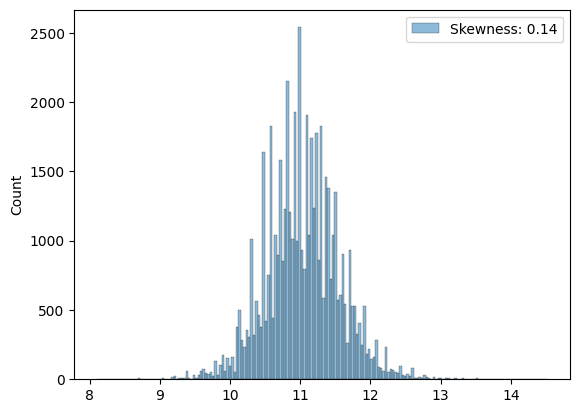

In [25]:
#Very positively skewed - see if log transform would help

pl.log_transform(['annual_inc'])

In [26]:
# Much more like normal distribution. Add to list to transform with log transform.
log_transform_cols.append('annual_inc')

Skew recoveries

14.382675406825468


,Column,Mean,Median,Mode,Std Dev,Var,Max,Min
0,recoveries,92.202658,0.0,0.0,620.644544,385199.650303,27750.0,0.0


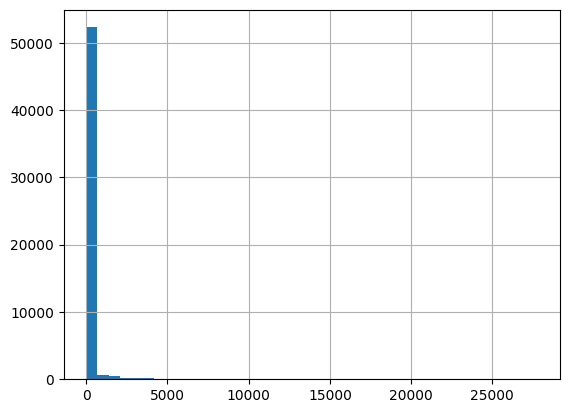

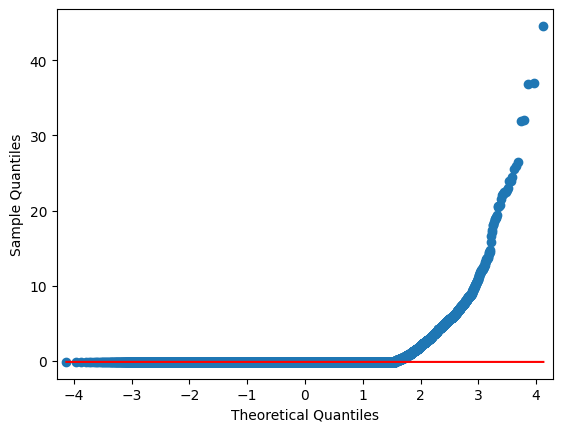

In [27]:
# recoveries next:

pl.col_hist('recoveries')
pl.qq_plot('recoveries')
dfi.df_stats(['recoveries'])

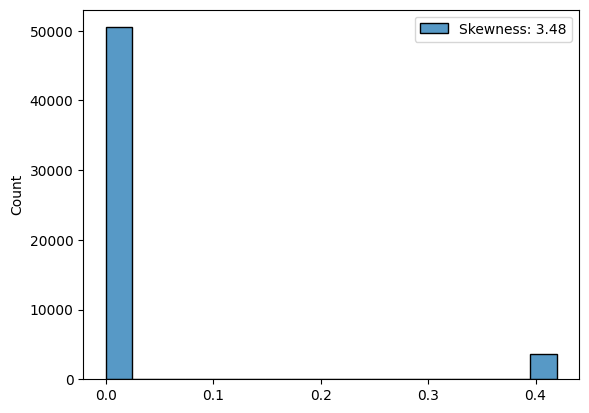

In [28]:
#pl.log_transform(['recoveries'])
#pl.box_cox_transform('recoveries') - not working, says data must be positive but it is!
pl.yeo_johnson('recoveries')

In [29]:
# Still v skewed, doesn't seem much point transforming

Skew out_prncp

2.352525970614482


,Column,Mean,Median,Mode,Std Dev,Var,Max,Min
0,out_prncp,2760.179346,0.0,0.0,5158.512063,2.661025e+07,32399.94,0.0


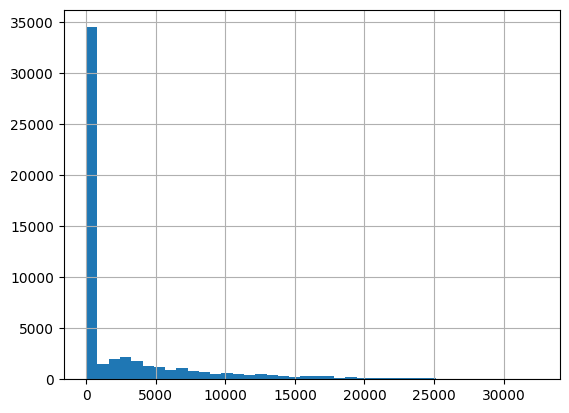

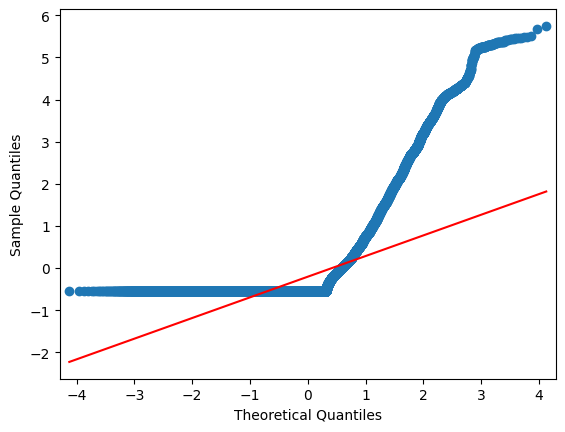

In [30]:
pl.col_hist('out_prncp')
pl.qq_plot('out_prncp')
dfi.df_stats(['out_prncp'])

c:\Users\karen\AiCore\15-Project\EDA\exploratory-data-analysis---customer-loans-in-finance883\transform.py:341: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  t=sns.histplot(log_col,label="Skewness: %.2f"%(log_col.skew()) )


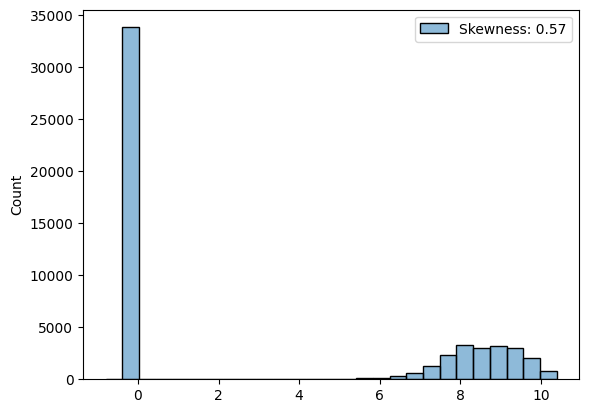

In [31]:
pl.log_transform(['out_prncp'])
#pl.yeo_johnson('out_prncp')

In [32]:
# Not much difference in skew with yeo_johnson, but nonzero columns look better with log transform, and best to use simplest 
# transformation where possible.

log_transform_cols.append('out_prncp')
print(log_transform_cols)

['annual_inc', 'out_prncp']


Skew inq_last_6mths

3.243836167526465


,Column,Mean,Median,Mode,Std Dev,Var,Max,Min
0,inq_last_6mths,0.891922,0.0,0,1.257632,1.581639,33,0


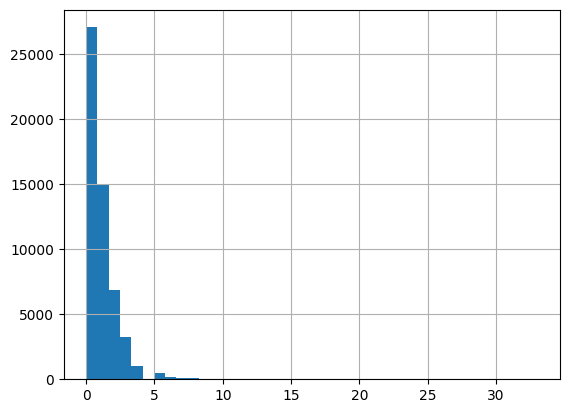

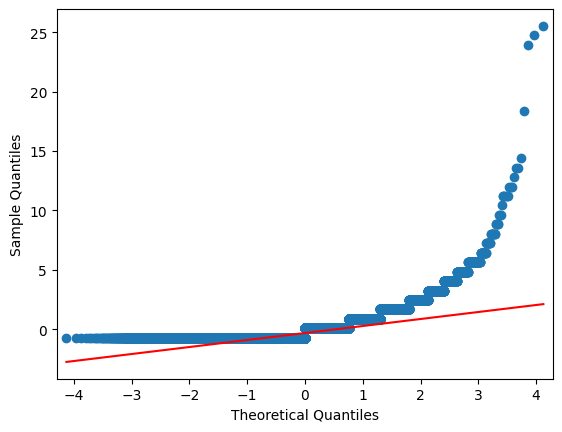

In [33]:
pl.col_hist('inq_last_6mths')
pl.qq_plot('inq_last_6mths')
dfi.df_stats(['inq_last_6mths'])

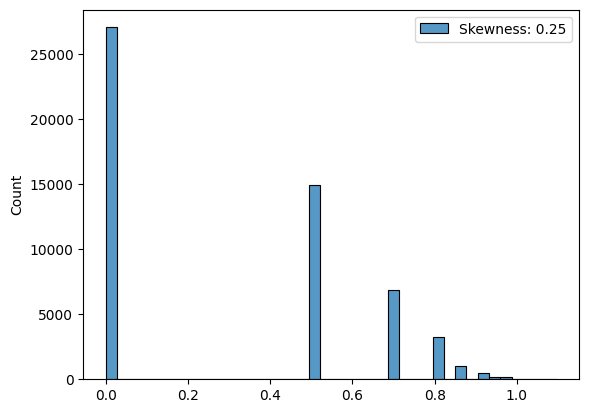

In [34]:
#pl.log_transform(['inq_last_6mths'])
pl.yeo_johnson('inq_last_6mths')

In [35]:
yeo_transform_cols.append('inq_last_6mths')

Skew total_payment

1.2692662197762663


,Column,Mean,Median,Mode,Std Dev,Var,Max,Min
0,total_payment,12099.322396,10130.703339,8302.5,8387.825058,7.035561e+07,55758.222084,33.73


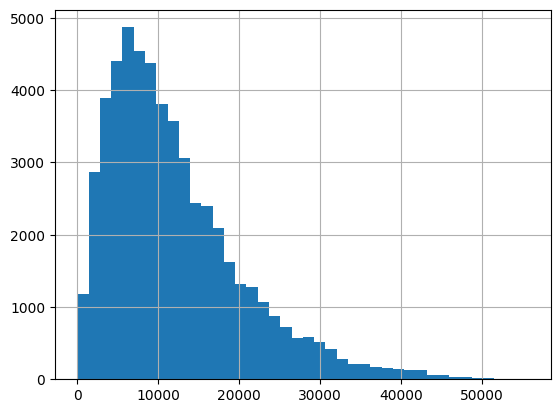

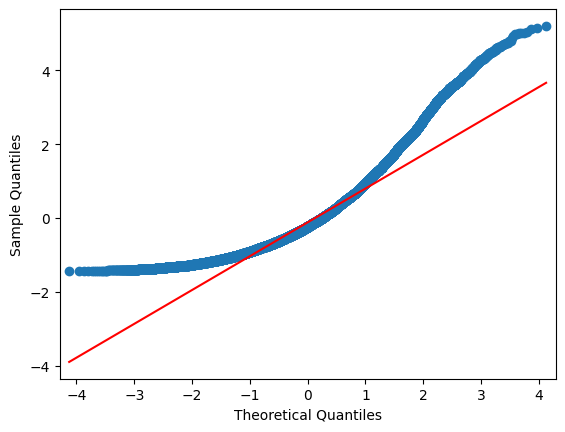

In [36]:
pl.col_hist('total_payment')
pl.qq_plot('total_payment')
dfi.df_stats(['total_payment'])

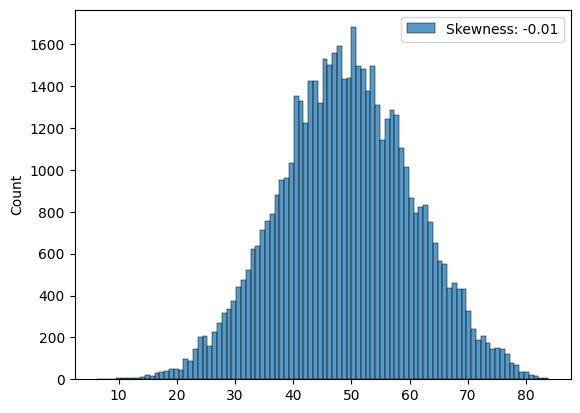

In [37]:
#pl.log_transform(['total_payment'])
pl.yeo_johnson('total_payment')

In [38]:
yeo_transform_cols.append('total_payment')
print(yeo_transform_cols)

['inq_last_6mths', 'total_payment']


Skew total_rec_int

2.203625284669197


,Column,Mean,Median,Mode,Std Dev,Var,Max,Min
0,total_rec_int,2582.719067,1739.23,1745.58,2582.41533,6.668869e+06,23062.45,6.22


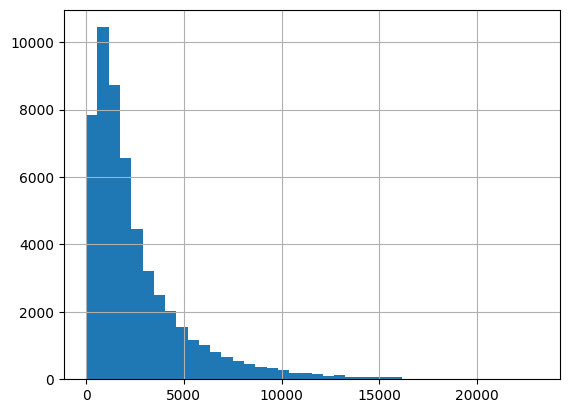

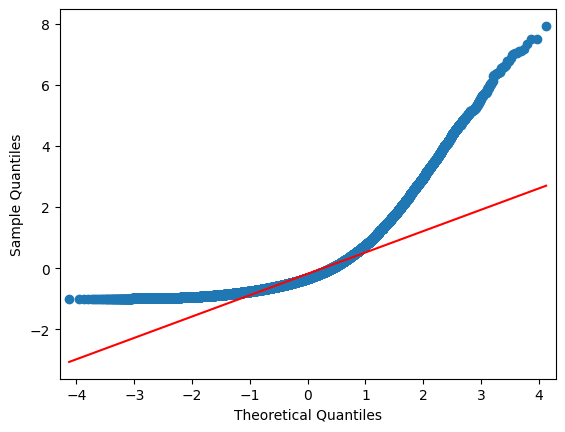

In [39]:
pl.col_hist('total_rec_int')
pl.qq_plot('total_rec_int')
dfi.df_stats(['total_rec_int'])

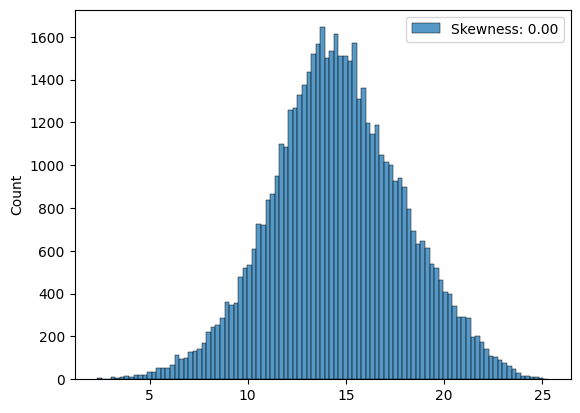

In [40]:
#pl.log_transform(['total_rec_int'])
pl.yeo_johnson('total_rec_int')

In [41]:
yeo_transform_cols.append('total_rec_int')
print(yeo_transform_cols)

['inq_last_6mths', 'total_payment', 'total_rec_int']


Skew delinq_2yrs

5.318817917464191


,Column,Mean,Median,Mode,Std Dev,Var,Max,Min
0,delinq_2yrs,0.241386,0.0,0,0.704215,0.495919,18,0


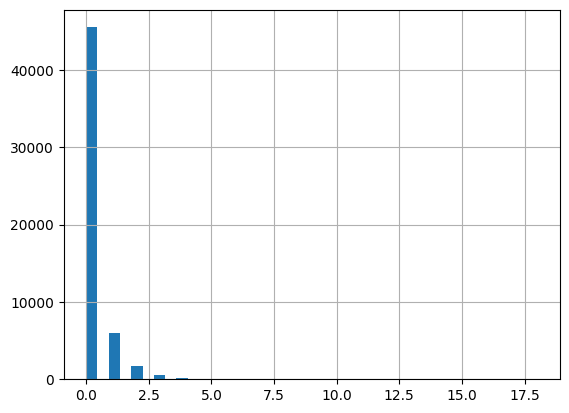

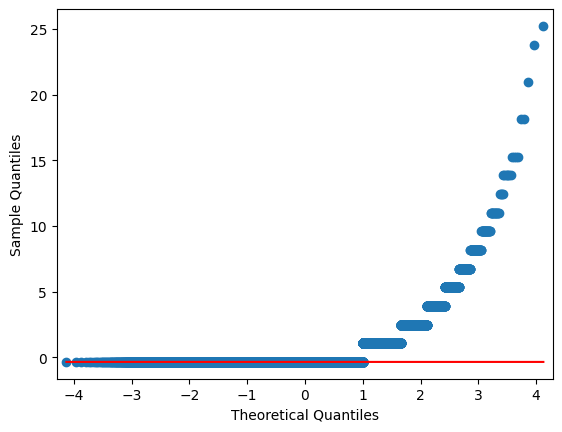

In [42]:
pl.col_hist('delinq_2yrs')
pl.qq_plot('delinq_2yrs')
dfi.df_stats(['delinq_2yrs'])

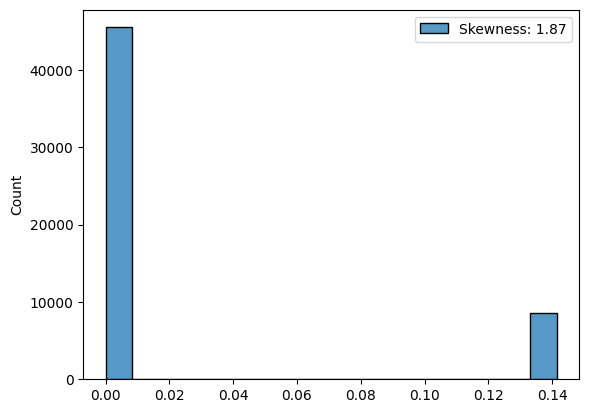

In [43]:
#pl.log_transform(['delinq_2yrs'])
pl.yeo_johnson('delinq_2yrs')


In [44]:
yeo_transform_cols.append('delinq_2yrs')
print(yeo_transform_cols)

['inq_last_6mths', 'total_payment', 'total_rec_int', 'delinq_2yrs']


Skew last_payment_amount

2.496078600255455


,Column,Mean,Median,Mode,Std Dev,Var,Max,Min
0,last_payment_amount,3137.371503,564.26,332.1,5328.015544,2.838775e+07,36115.2,0.0


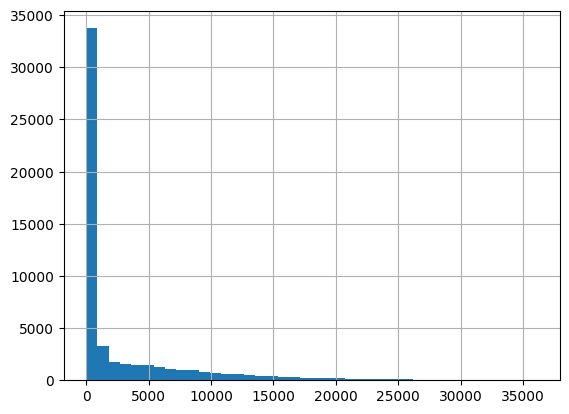

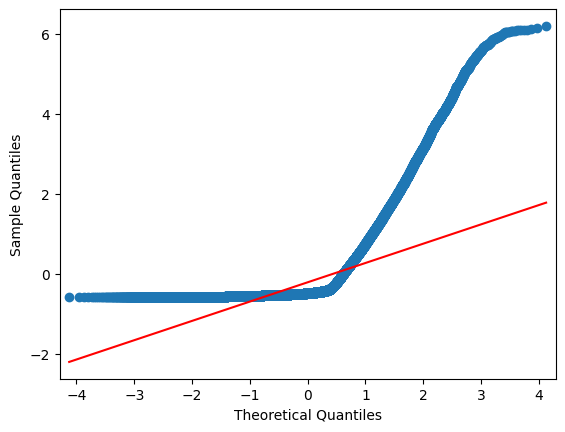

In [45]:

pl.col_hist('last_payment_amount')
pl.qq_plot('last_payment_amount')
dfi.df_stats(['last_payment_amount'])

In [160]:
#pl.log_transform(['last_payment_amount'])
pl.yeo_johnson('last_payment_amount')

BracketError: The algorithm terminated without finding a valid bracket. Consider trying different initial points.

Skew total_rec_prncp

1.262007269838639


,Column,Mean,Median,Mode,Std Dev,Var,Max,Min
0,total_rec_prncp,9423.503581,7672.15,10000.0,6955.881319,4.838428e+07,35000.02,0.0


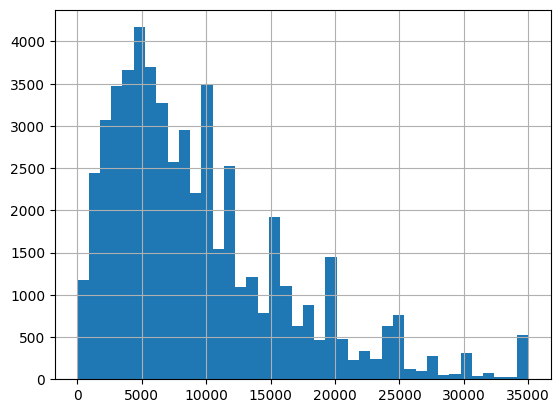

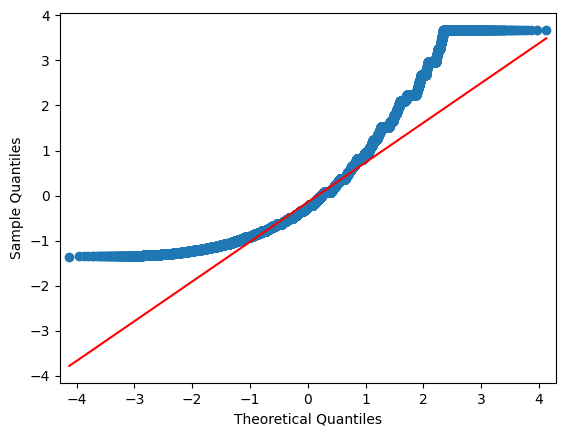

In [47]:

pl.col_hist('total_rec_prncp')
pl.qq_plot('total_rec_prncp')
dfi.df_stats(['total_rec_prncp'])

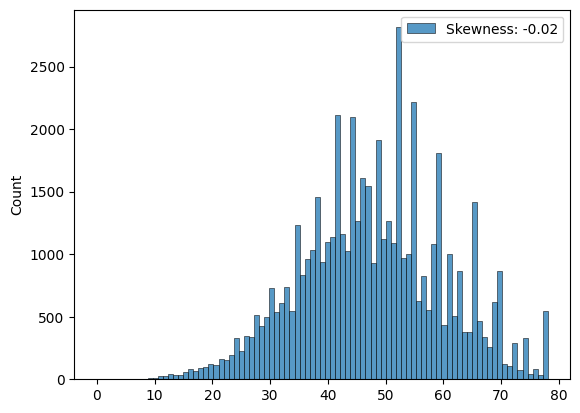

In [48]:
#pl.log_transform(['total_rec_prncp'])
pl.yeo_johnson('total_rec_prncp')

In [49]:
yeo_transform_cols.append('total_rec_prncp')
print(yeo_transform_cols)

['inq_last_6mths', 'total_payment', 'total_rec_int', 'delinq_2yrs', 'total_rec_prncp']


Skew total_rec_late_fee

13.258471830549329


,Column,Mean,Median,Mode,Std Dev,Var,Max,Min
0,total_rec_late_fee,0.897099,0.0,0.0,6.198683,38.423672,358.68,0.0


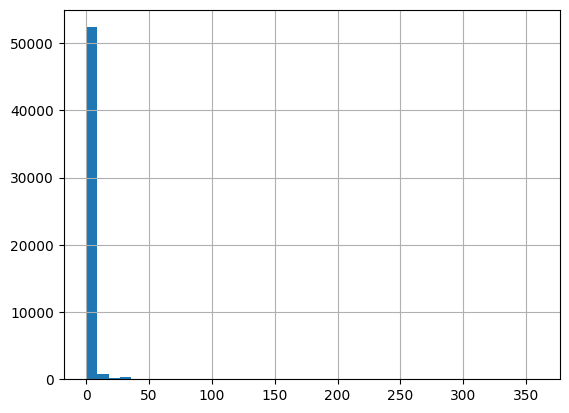

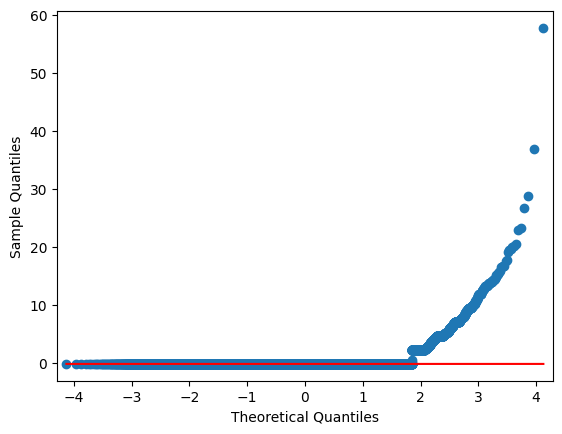

In [50]:
pl.col_hist('total_rec_late_fee')
pl.qq_plot('total_rec_late_fee')
dfi.df_stats(['total_rec_late_fee'])

c:\Users\karen\AiCore\15-Project\EDA\exploratory-data-analysis---customer-loans-in-finance883\transform.py:341: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  t=sns.histplot(log_col,label="Skewness: %.2f"%(log_col.skew()) )


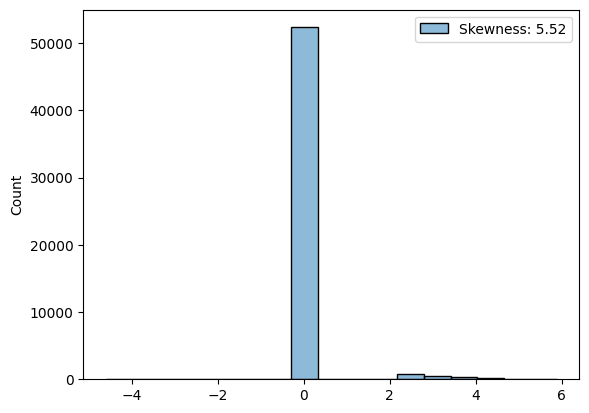

In [51]:
pl.log_transform(['total_rec_late_fee'])
#pl.yeo_johnson('total_rec_late_fee')

In [52]:
#still skewed, not sure there's much point transforming

Skew collection_recovery_fee

27.794716127396722


,Column,Mean,Median,Mode,Std Dev,Var,Max,Min
0,collection_recovery_fee,10.788851,0.0,0.0,119.963569,14391.258003,7002.19,0.0


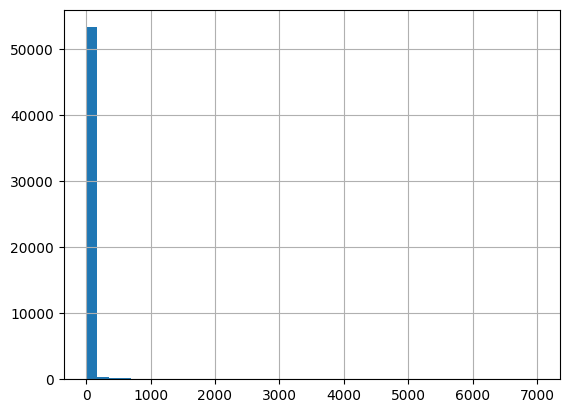

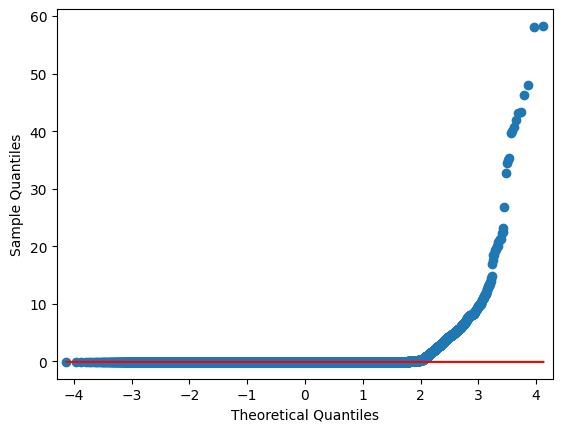

In [53]:
pl.col_hist('collection_recovery_fee')
pl.qq_plot('collection_recovery_fee')
dfi.df_stats(['collection_recovery_fee'])

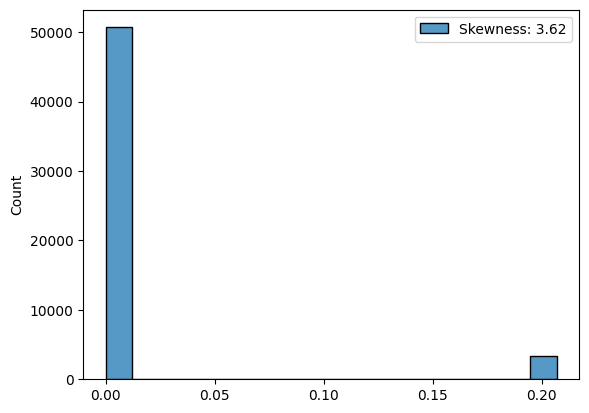

In [54]:
#pl.log_transform(['collection_recovery_fee'])
pl.yeo_johnson('collection_recovery_fee')

In [55]:
# again skew still high, not sure any point transforming

Skew collections_12_mths_ex_med

20.29806369008403


,Column,Mean,Median,Mode,Std Dev,Var,Max,Min
0,collections_12_mths_ex_med,0.004196,0.0,0.0,0.070913,0.005029,4.0,0.0


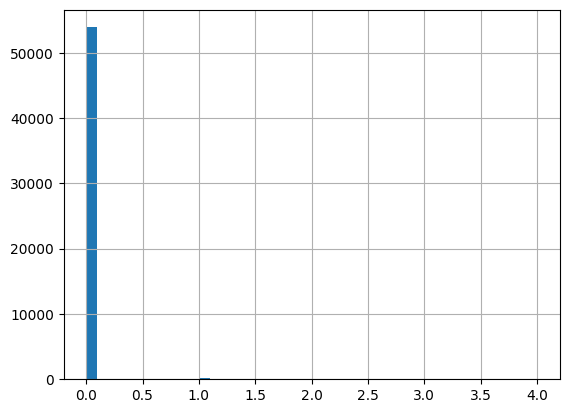

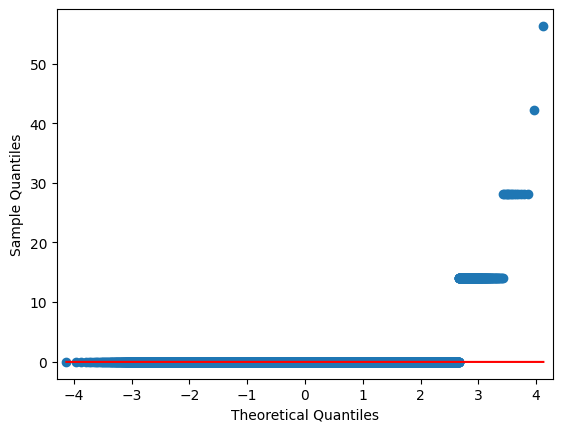

In [56]:
pl.col_hist('collections_12_mths_ex_med')
pl.qq_plot('collections_12_mths_ex_med')
dfi.df_stats(['collections_12_mths_ex_med'])

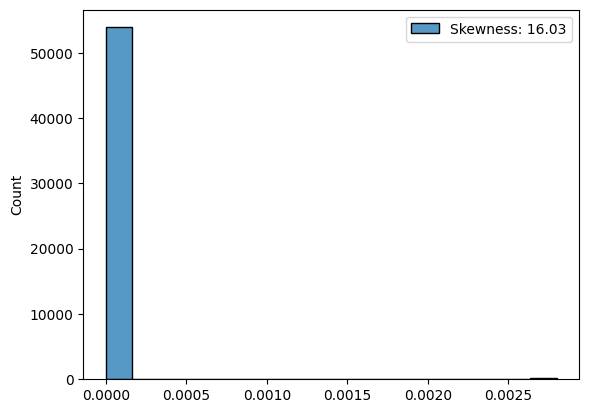

In [57]:
#pl.log_transform(['collections_12_mths_ex_med'])
pl.yeo_johnson('collections_12_mths_ex_med')

In [58]:
# don't think there's much point transforming this one - skew still very high

Skew term_months

1.1463315618353964


,Column,Mean,Median,Mode,Std Dev,Var,Max,Min
0,term_months,42.032828,36.0,36.0,10.411285,108.394863,60.0,36.0


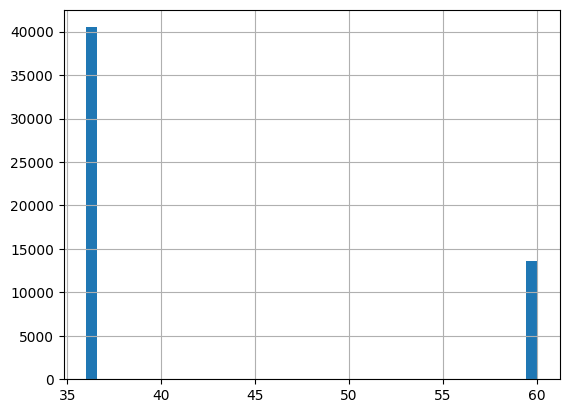

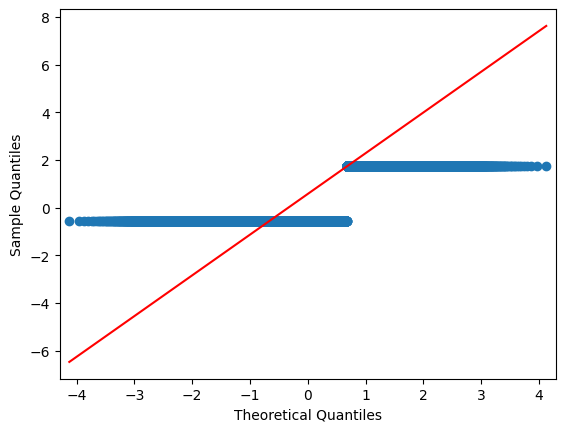

In [59]:
pl.col_hist('term_months')
pl.qq_plot('term_months')
dfi.df_stats(['term_months'])

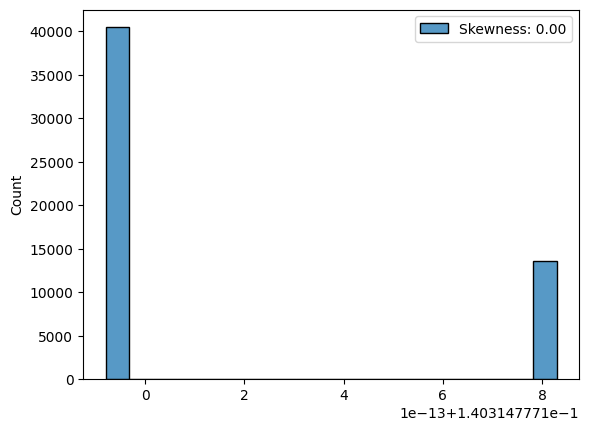

In [60]:
#pl.log_transform(['term_months'])
pl.yeo_johnson('term_months')

In [61]:
yeo_transform_cols.append('term_months')
print(yeo_transform_cols)

['inq_last_6mths', 'total_payment', 'total_rec_int', 'delinq_2yrs', 'total_rec_prncp', 'term_months']


Skew open_accounts

1.0594931166880517


,Column,Mean,Median,Mode,Std Dev,Var,Max,Min
0,open_accounts,10.56549,10.0,9,4.796082,23.002402,53,1


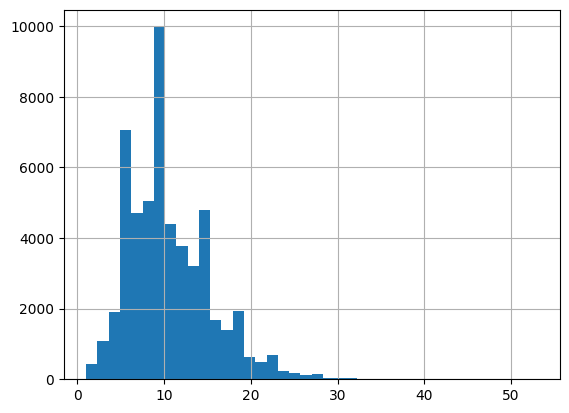

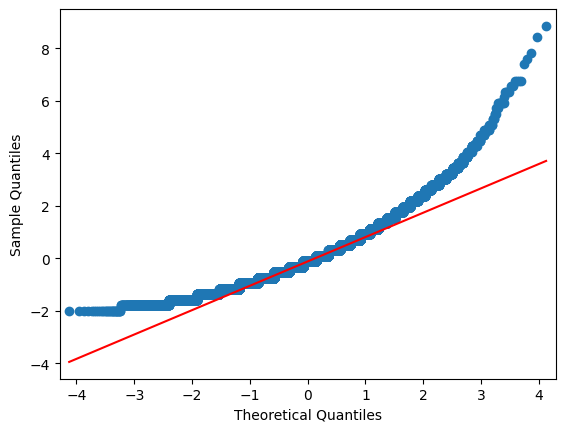

In [62]:
pl.col_hist('open_accounts')
pl.qq_plot('open_accounts')
dfi.df_stats(['open_accounts'])

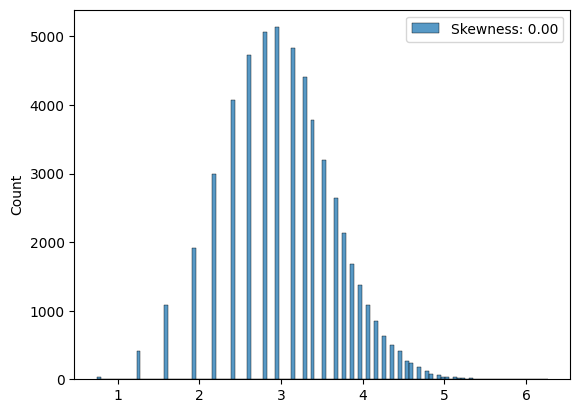

In [63]:
#pl.log_transform(['open_accounts'])
pl.yeo_johnson('open_accounts')

In [64]:
yeo_transform_cols.append('open_accounts')
print(yeo_transform_cols)

['inq_last_6mths', 'total_payment', 'total_rec_int', 'delinq_2yrs', 'total_rec_prncp', 'term_months', 'open_accounts']


Skew total_payment_inv

1.2584742300393752


,Column,Mean,Median,Mode,Std Dev,Var,Max,Min
0,total_payment_inv,11813.597781,9855.775,0.0,8357.061608,6.984048e+07,55061.0,0.0


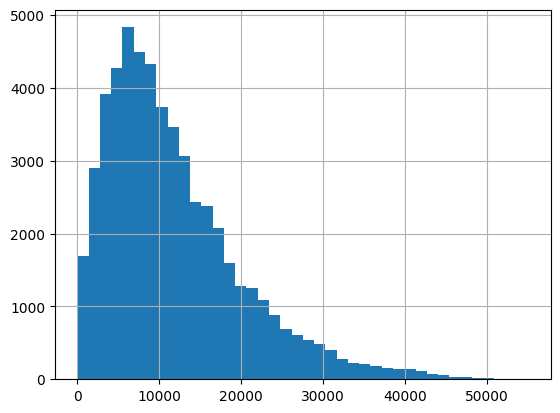

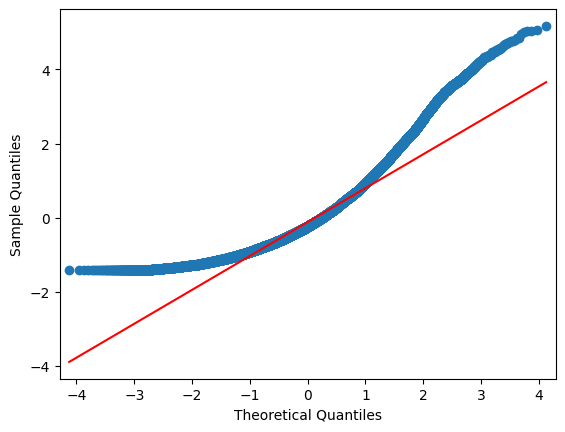

In [65]:
pl.col_hist('total_payment_inv')
pl.qq_plot('total_payment_inv')
dfi.df_stats(['total_payment_inv'])

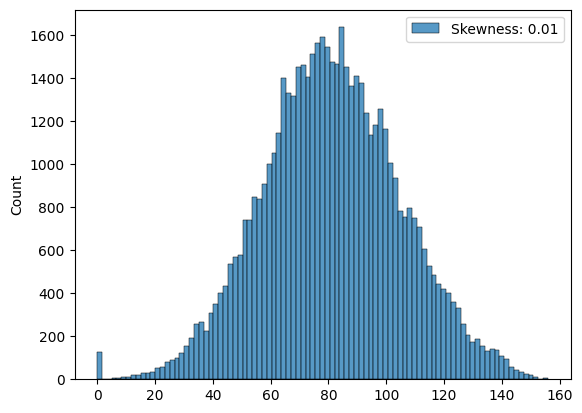

In [66]:
#pl.log_transform(['total_payment_inv'])
pl.yeo_johnson('total_payment_inv')

In [67]:
yeo_transform_cols.append('total_payment_inv')
print(yeo_transform_cols)

['inq_last_6mths', 'total_payment', 'total_rec_int', 'delinq_2yrs', 'total_rec_prncp', 'term_months', 'open_accounts', 'total_payment_inv']


Skew out_prncp_inv

2.3529464346145614


,Column,Mean,Median,Mode,Std Dev,Var,Max,Min
0,out_prncp_inv,2758.779941,0.0,0.0,5156.660568,2.659115e+07,32399.94,0.0


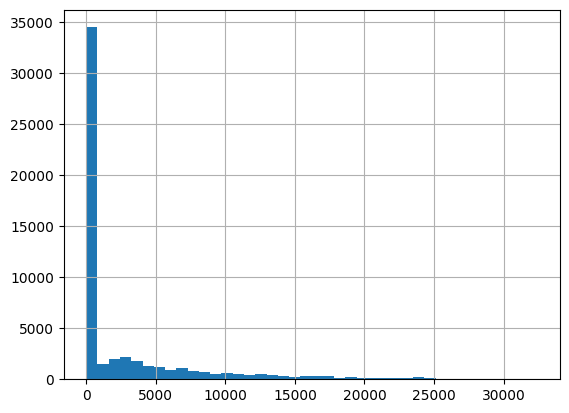

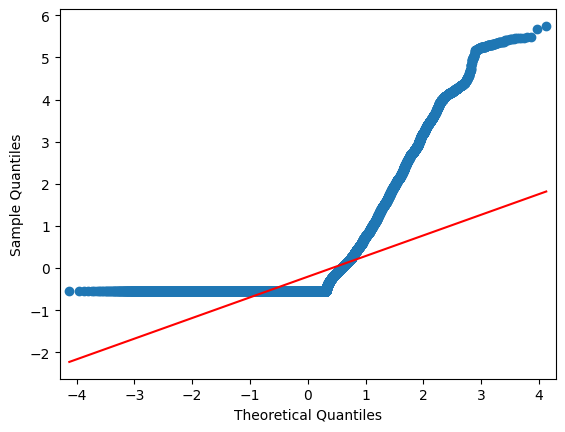

In [68]:
pl.col_hist('out_prncp_inv')
pl.qq_plot('out_prncp_inv')
dfi.df_stats(['out_prncp_inv'])

c:\Users\karen\AiCore\15-Project\EDA\exploratory-data-analysis---customer-loans-in-finance883\transform.py:341: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  t=sns.histplot(log_col,label="Skewness: %.2f"%(log_col.skew()) )


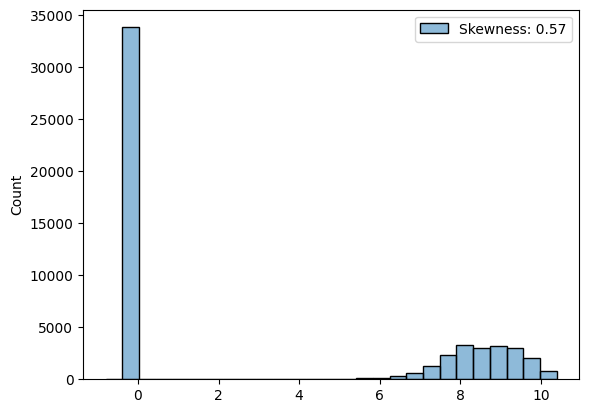

In [69]:
pl.log_transform(['out_prncp_inv'])
#pl.yeo_johnson('out_prncp_inv')

In [70]:
yeo_transform_cols.append('out_prncp_inv')
print(yeo_transform_cols)

['inq_last_6mths', 'total_payment', 'total_rec_int', 'delinq_2yrs', 'total_rec_prncp', 'term_months', 'open_accounts', 'total_payment_inv', 'out_prncp_inv']


#### Apply transforms to skewed columns

In [71]:
dft = tf.DataFrameTransform(pl.df)
dft.apply_log_transforms(log_transform_cols)
dft.apply_yeo_transforms(yeo_transform_cols)
print(dft.df[skewed_cols].skew())

c:\Users\karen\AiCore\15-Project\EDA\exploratory-data-analysis---customer-loans-in-finance883\transform.py:548: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.df[col] = self.df[col].map(lambda i: np.log(i) if i > 0 else 0)
c:\Users\karen\AiCore\15-Project\EDA\exploratory-data-analysis---customer-loans-in-finance883\transform.py:567: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.df[col] = yeojohnson_col


term_months                    0.000000
annual_inc                     0.141818
delinq_2yrs                    1.869919
inq_last_6mths                 0.250961
open_accounts                  0.001399
out_prncp                      0.573256
out_prncp_inv                  0.528326
total_payment                 -0.014033
total_payment_inv              0.005727
total_rec_prncp               -0.017952
total_rec_int                  0.001459
total_rec_late_fee            13.258472
recoveries                    14.382675
collection_recovery_fee       27.794716
last_payment_amount            2.496079
collections_12_mths_ex_med    20.298064
dtype: float64


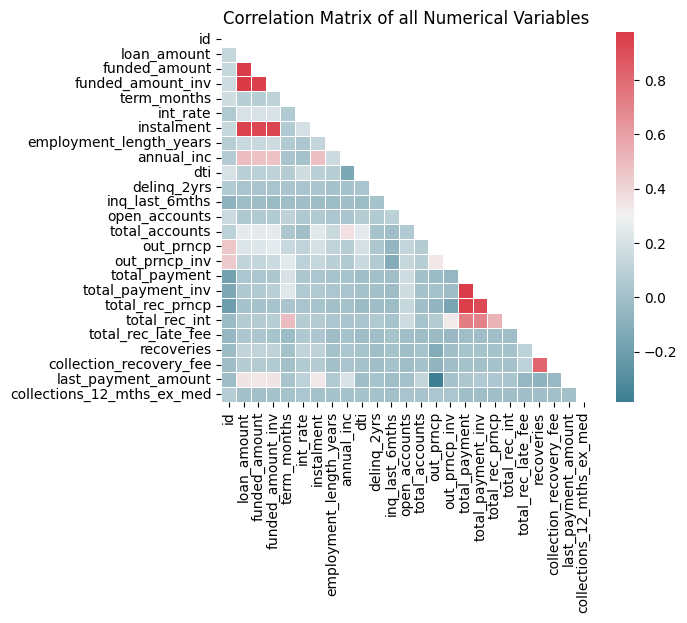

,id,loan_amount,funded_amount,funded_amount_inv,term_months,int_rate,instalment,employment_length_years,annual_inc,dti,delinq_2yrs,inq_last_6mths,open_accounts,total_accounts,out_prncp,out_prncp_inv,total_payment,total_payment_inv,total_rec_prncp,total_rec_int,total_rec_late_fee,recoveries,collection_recovery_fee,last_payment_amount,collections_12_mths_ex_med
id,1.000000,0.132562,0.139221,0.166564,0.171357,0.055993,0.136875,0.078365,0.064204,0.200424,0.057753,-0.073997,0.152876,0.101797,0.460020,0.443022,-0.177772,-0.135024,-0.202733,-0.029028,-0.050191,-0.029954,-0.020567,-0.020305,0.074351
loan_amount,0.132562,1.000000,0.964843,0.975552,0.078596,0.203370,0.947044,0.146298,0.489129,0.093133,0.021936,-0.021656,0.048030,0.250945,0.218236,0.120532,0.030946,0.051309,0.010661,0.063797,0.032443,0.116697,0.068160,0.347514,0.001607
funded_amount,0.139221,0.964843,1.000000,0.953772,0.080573,0.200280,0.926736,0.144015,0.472305,0.094641,0.021531,-0.020648,0.051682,0.244259,0.221866,0.126106,0.032737,0.053586,0.011721,0.065612,0.030558,0.111796,0.064488,0.336114,0.003650
funded_amount_inv,0.166564,0.975552,0.953772,1.000000,0.106135,0.210227,0.935447,0.158850,0.474896,0.109378,0.023934,-0.033510,0.061469,0.249338,0.249789,0.153385,0.042266,0.086636,0.017712,0.080373,0.017770,0.108362,0.059888,0.345211,0.004311
term_months,0.171357,0.078596,0.080573,0.106135,1.000000,0.059711,0.060564,0.057411,0.028188,0.071964,0.028283,-0.009235,0.105686,0.032184,0.142499,0.241891,0.204004,0.234358,0.028595,0.487157,-0.032312,0.007439,-0.000917,0.024706,0.011395
int_rate,0.055993,0.203370,0.200280,0.210227,0.059711,1.000000,0.191054,0.035612,0.007392,0.171911,0.027796,-0.005494,0.048852,-0.017264,0.114976,0.100667,0.042129,0.053949,0.022243,0.072373,0.048146,0.111767,0.059111,0.100397,0.032757
instalment,0.136875,0.947044,0.926736,0.935447,0.060564,0.191054,1.000000,0.130412,0.482023,0.092095,0.026163,-0.018212,0.052846,0.233370,0.192962,0.133773,0.034757,0.051822,0.014939,0.066784,0.039954,0.108940,0.068307,0.331146,0.005288
employment_length_years,0.078365,0.146298,0.144015,0.158850,0.057411,0.035612,0.130412,1.000000,0.161073,0.080783,0.014065,-0.024270,0.033915,0.151090,0.112750,0.088931,0.014790,0.033866,0.001365,0.040343,-0.020097,0.008026,0.002821,0.055826,0.012052
annual_inc,0.064204,0.489129,0.472305,0.474896,0.028188,0.007392,0.482023,0.161073,1.000000,-0.144164,0.012068,-0.004478,0.025555,0.362966,0.075258,0.052718,0.014746,0.023549,0.007916,0.023843,0.010180,0.033930,0.023532,0.207311,0.010092
dti,0.200424,0.093133,0.094641,0.109378,0.071964,0.171911,0.092095,0.080783,-0.144164,1.000000,0.023303,-0.025919,0.072174,0.249896,0.192414,0.147125,-0.012887,0.005340,-0.028244,0.029764,-0.020131,0.017138,0.003748,-0.012769,0.012073


In [72]:
# just a test
num_cols = list(num_cols)
pl.correlation_matrix(num_cols)

slope of regression line:  7454.459264507666
Mean Squared Error (MSE) of the regression line:  49678256.10722756


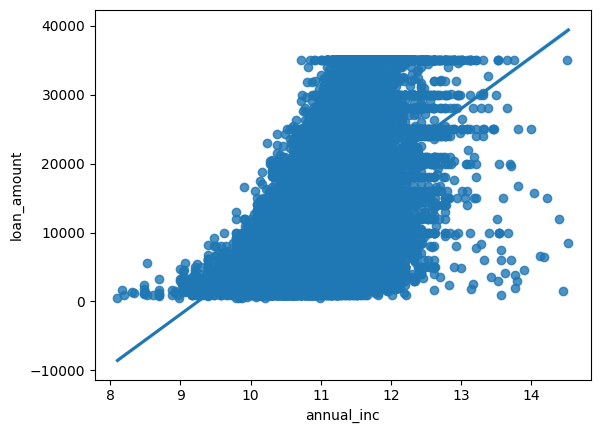

In [73]:
#just a test
pl.regression_plot('annual_inc','loan_amount')

In [74]:
pl.box_and_whisker(['annual_inc'])


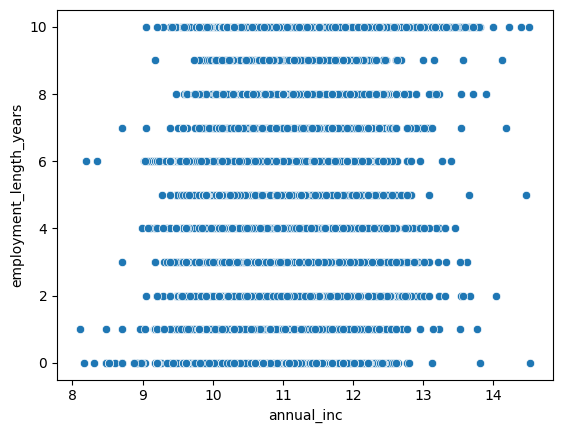

In [75]:
pl.scatter_plot('annual_inc', 'employment_length_years')

### IDENTIFY OUTLIERS

In [76]:
# first update df in DataFrameInfo and Plotter classes following skew transforms
pl = tf.Plotter(dft.df)
dfi = tf.DataFrameInfo(dft.df)


Outliers loan_amount

In [77]:
# Let's just start with random column - loan_amount:

dft_z = tf.DataFrameTransform(dft.df.copy())
col = 'loan_amount'
dft_z = dft_z.calc_z_scores(col)
mask = dft_z.df[col + '_z'].abs() > 3
print(dft_z.df[mask][col + '_z'].sort_values())


Series([], Name: loan_amount_z, dtype: float64)


In [78]:
col = 'loan_amount'
df_outliers = dft.calc_outliers_IQR(col)
print(df_outliers[col].value_counts())


loan_amount
35000    1491
34875       3
34800       1
34925       1
Name: count, dtype: int64


0.8043121863503576


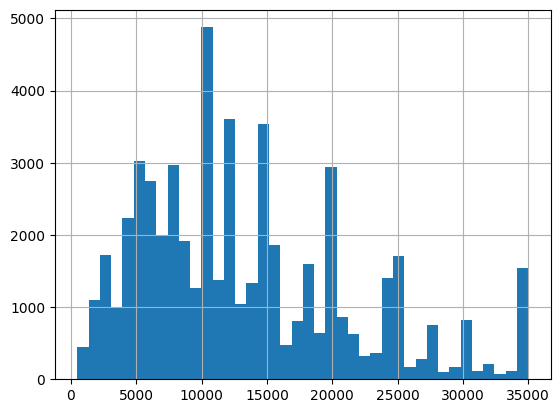

In [79]:
# no values are less than 3 std dev's away from mean, but some fall outside fences

pl.col_hist('loan_amount')
pl.box_and_whisker('loan_amount')


In [80]:
# Why is there a spike at the top end? Checked original distribution which doesn't have this, so maybe due to transform?

# remove outliers:

dft.remove_outliers(df_outliers)
print(len(dft.df))

52604


Outliers int_rate

In [81]:
pl = tf.Plotter(dft.df)
col = 'int_rate'
dft_z = dft_z.calc_z_scores(col)
mask = dft_z.df[col + '_z'].abs() > 3
print(dft_z.df[mask][col + '_z'].sort_values())

1828     3.010568
30840    3.010568
30548    3.010568
29718    3.010568
28745    3.010568
28700    3.010568
26605    3.010568
25194    3.010568
24376    3.010568
23016    3.010568
22413    3.010568
20571    3.010568
18862    3.010568
17484    3.010568
16914    3.010568
14633    3.010568
7586     3.010568
5951     3.010568
4809     3.010568
3566     3.010568
31636    3.010568
31644    3.010568
Name: int_rate_z, dtype: float64


In [82]:
col = 'int_rate'
df_outliers = dft.calc_outliers_IQR(col)
print(df_outliers[col].value_counts())

int_rate
23.40    200
24.50    178
24.08    175
23.70    151
24.99    103
25.57     74
25.80     62
25.83     53
23.50     53
24.89     50
25.89     40
25.28     28
25.99     21
23.99     18
26.06     18
23.22      4
23.52      3
24.11      2
23.91      1
24.59      1
24.40      1
23.59      1
Name: count, dtype: int64


0.4569262766798519


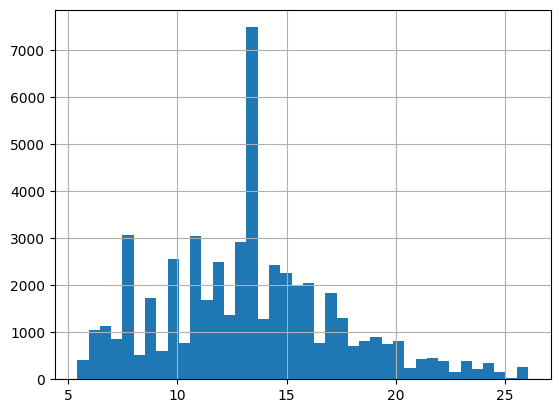

In [83]:
pl = tf.Plotter(dft.df)
pl.col_hist('int_rate')
pl.box_and_whisker('int_rate')

In [84]:
# remove outliers

dft.remove_outliers(df_outliers)
print(len(dft.df))

51367


Outliers funded_amount

In [85]:
col = 'funded_amount'
dft_z = dft_z.calc_z_scores(col)
mask = dft_z.df[col + '_z'].abs() > 3
print(dft_z.df[mask][col + '_z'].sort_values())

Series([], Name: funded_amount_z, dtype: float64)


In [86]:
df_outliers = dft.calc_outliers_IQR(col)
print(df_outliers[col].value_counts())

funded_amount
30000.0    662
32000.0     95
31300.0     38
33425.0     31
33000.0     31
32350.0     28
34475.0     24
34000.0     23
30750.0     18
31825.0     18
32875.0     17
33950.0     16
33600.0     16
31000.0     14
30225.0     14
32400.0      7
30075.0      6
30800.0      5
32500.0      5
31500.0      4
31200.0      3
31700.0      3
31050.0      3
29975.0      3
30500.0      2
30400.0      2
31800.0      2
34400.0      2
33500.0      2
32200.0      2
31325.0      2
32750.0      2
31450.0      2
30900.0      1
32425.0      1
32100.0      1
32450.0      1
34325.0      1
33350.0      1
31600.0      1
32275.0      1
34525.0      1
31150.0      1
33450.0      1
30600.0      1
32325.0      1
32250.0      1
34575.0      1
30850.0      1
31175.0      1
29950.0      1
31575.0      1
34200.0      1
34100.0      1
32950.0      1
32225.0      1
33300.0      1
34550.0      1
30375.0      1
34500.0      1
31900.0      1
30875.0      1
31950.0      1
30100.0      1
32525.0      1
Name: count

0.6896580590877487


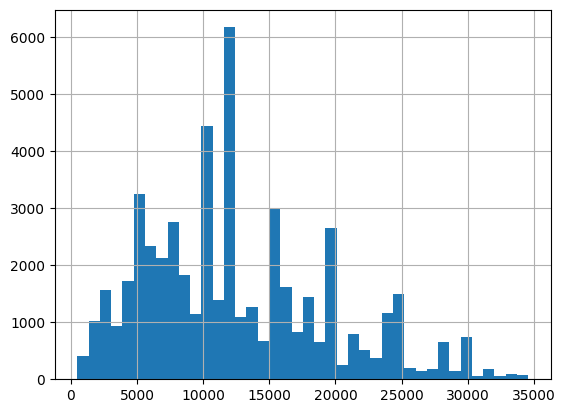

In [87]:
pl = tf.Plotter(dft.df)
pl.col_hist('funded_amount')
pl.box_and_whisker('funded_amount')

In [88]:
# remove outliers

dft.remove_outliers(df_outliers)
print(len(dft.df))

50233


Outliers funded_amount_inv

In [89]:
col = 'funded_amount_inv'
dft_z = dft_z.calc_z_scores(col)
mask = dft_z.df[col + '_z'].abs() > 3
print(dft_z.df[mask][col + '_z'].sort_values())

Series([], Name: funded_amount_inv_z, dtype: float64)


In [90]:
df_outliers = dft.calc_outliers_IQR(col)
print(df_outliers[col].value_counts())

funded_amount_inv
32000.000000    5
31300.000000    4
33425.000000    3
32350.000000    2
33000.000000    2
34475.000000    1
31950.000000    1
33500.000000    1
32250.000000    1
31275.000000    1
33750.000000    1
33900.000000    1
32150.000000    1
32300.000000    1
31900.000000    1
32475.000000    1
33950.000000    1
34000.000000    1
32193.008671    1
Name: count, dtype: int64


0.5315559590252315


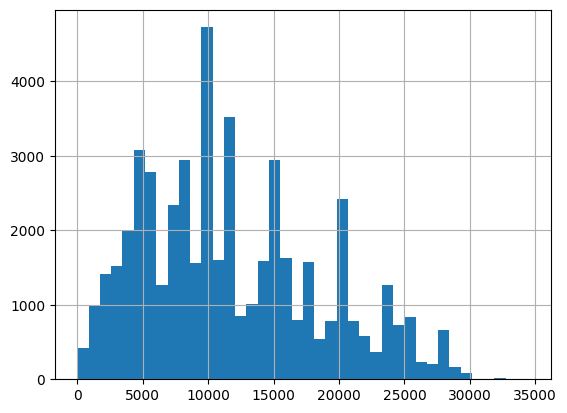

In [91]:
pl = tf.Plotter(dft.df)
pl.col_hist('funded_amount_inv')
pl.box_and_whisker('funded_amount_inv')

In [92]:
# remove outliers

dft.remove_outliers(df_outliers)
print(len(dft.df))

50203


Outliers instalment

In [93]:
col = 'instalment'
dft_z = dft_z.calc_z_scores(col)
mask = dft_z.df[col + '_z'].abs() > 3
print(dft_z.df[mask][col + '_z'].sort_values())

24868    3.003461
38949    3.006056
16976    3.007940
31142    3.011205
319      3.016773
           ...   
5488     4.211746
15141    4.211746
6750     4.211746
3863     4.214090
6935     4.214090
Name: instalment_z, Length: 671, dtype: float64


In [94]:
df_outliers = dft.calc_outliers_IQR(col)
print(df_outliers[col].value_counts())

instalment
929.87     19
943.30     14
952.50     12
961.06     10
979.02      8
           ..
963.08      1
1073.74     1
951.91      1
950.89      1
914.42      1
Name: count, Length: 250, dtype: int64


0.6733571469698932


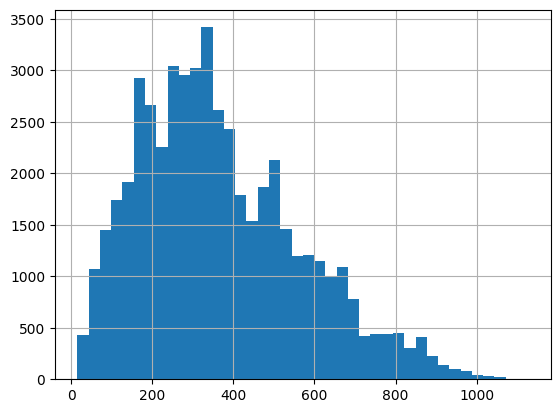

In [95]:
pl = tf.Plotter(dft.df)
pl.col_hist('instalment')
pl.box_and_whisker('instalment')

-0.020438697323002256
-0.020438697323002256


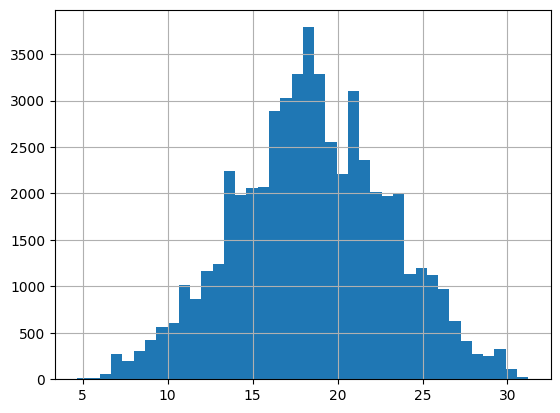

In [96]:
# Quite a few at top end - worth transforming? The skew was only just under 1. Try transforming to reduce effect of outliers?

dft_z.apply_yeo_transforms(['instalment'])
pl = tf.Plotter(dft_z.df)
print(dft_z.df['instalment'].skew())
pl.col_hist('instalment')
pl.box_and_whisker('instalment')


In [97]:
# transform seems to have balanced things out - make same change to dft df (as dft_z is only temporary to store z scores) and update dfi df

dft.apply_yeo_transforms(['instalment'])
dfi = tf.DataFrameInfo(dft_z.df)

Outliers annual_inc

In [98]:
col = 'annual_inc'
dft_z = dft_z.calc_z_scores(col)
mask = dft_z.df[col + '_z'].abs() > 3
print(dft_z.df[mask][col + '_z'].sort_values())

53470   -5.538481
53778   -5.427510
3512    -5.374381
47922   -5.138329
48697   -5.083660
           ...   
32650    6.014777
36887    6.327142
44958    6.448065
28376    6.544802
53565    6.581949
Name: annual_inc_z, Length: 409, dtype: float64


In [99]:
df_outliers = dft.calc_outliers_IQR(col)
print(df_outliers[col].value_counts())

annual_inc
9.392662     59
9.615805     57
12.429216    52
9.574983     47
12.611538    45
             ..
12.584509     1
9.588571      1
9.517531      1
9.517237      1
9.298351      1
Name: count, Length: 301, dtype: int64


0.10454919757342325


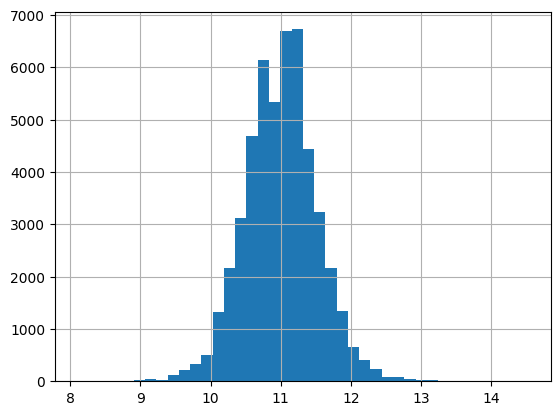

In [100]:
pl = tf.Plotter(dft.df)
pl.col_hist('annual_inc')
pl.box_and_whisker('annual_inc')

In [101]:
# remove outliers

dft.remove_outliers(df_outliers)
print(len(dft.df))

49289


Outliers dti

In [102]:
col = 'dti'
dft_z = dft_z.calc_z_scores(col)
mask = dft_z.df[col + '_z'].abs() > 3
print(dft_z.df[mask][col + '_z'].sort_values())

2888    3.006983
977     3.006983
1182    3.021419
62      3.025356
3893    3.025356
1383    3.030606
646     3.031918
3629    3.033230
2989    3.038480
2507    3.046354
1146    3.058165
2451    3.058165
449     3.060790
1551    3.067352
1375    3.068664
145     3.073913
1120    3.075226
1339    3.084412
3228    3.089662
475     3.090974
2108    3.100161
3492    3.101473
2405    3.102785
1457    3.102785
2134    3.119846
3841    3.121159
2414    3.127720
3300    3.127720
787     3.127720
792     3.131657
3837    3.143469
128     3.147406
1917    3.153968
Name: dti_z, dtype: float64


In [103]:
df_outliers = dft.calc_outliers_IQR(col)
print(df_outliers[col].value_counts())

dti
39.71    3
38.45    3
38.93    2
39.18    2
38.19    2
38.79    2
38.50    1
39.91    1
38.08    1
39.65    1
39.52    1
39.09    1
38.32    1
37.95    1
37.92    1
39.03    1
39.42    1
38.29    1
38.38    1
38.56    1
39.83    1
39.66    1
38.15    1
37.94    1
38.03    1
39.26    1
39.25    1
38.98    1
39.86    1
39.30    1
38.57    1
38.33    1
38.20    1
39.20    1
39.43    1
38.72    1
37.98    1
38.97    1
39.74    1
37.91    1
37.97    1
39.31    1
38.90    1
38.40    1
39.38    1
38.66    1
37.99    1
Name: count, dtype: int64


0.1912409561970518


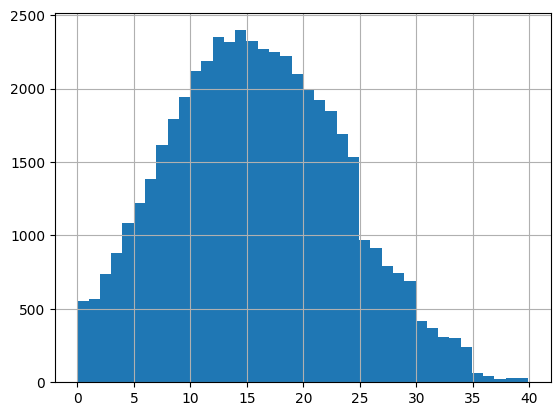

In [104]:
pl = tf.Plotter(dft.df)
pl.col_hist(col)
pl.box_and_whisker(col)

In [105]:
# remove outliers

dft.remove_outliers(mask)
print(len(dft.df))

49289


CHECK OUT what's with the sudden drop at 25, and less so at 30 and 35?

Outliers delinq_2yrs

In [106]:
col = 'delinq_2yrs'
dft_z = dft_z.calc_z_scores(col)
mask = dft_z.df[col + '_z'].abs() > 3
print(dft_z.df[mask][col + '_z'].sort_values())

Series([], Name: delinq_2yrs_z, dtype: float64)


In [107]:
df_outliers = dft.calc_outliers_IQR(col)
print(df_outliers[col].value_counts())

delinq_2yrs
-0.0    21
Name: count, dtype: int64


-18.989945068835564


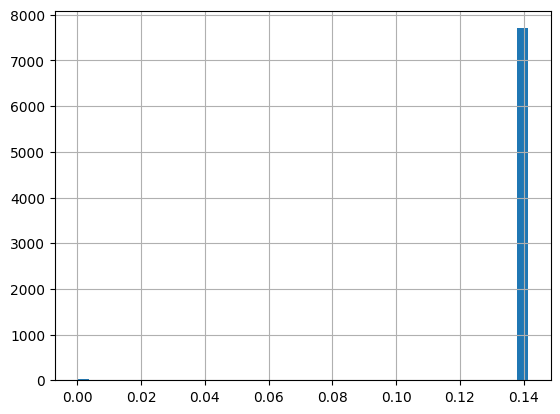

In [108]:
pl = tf.Plotter(dft.df)
pl.col_hist('delinq_2yrs')
pl.box_and_whisker('delinq_2yrs')

In [109]:
# Do nothing here - all non-zero values will be outliers

Outliers inq_last_6mths

In [110]:
col = 'inq_last_6mths'
dft_z = dft_z.calc_z_scores(col)
mask = dft_z.df[col + '_z'].abs() > 3
print(dft_z.df[mask][col + '_z'].sort_values())

Series([], Name: inq_last_6mths_z, dtype: float64)


In [111]:
df_outliers = dft.calc_outliers_IQR(col)
print(df_outliers[col].value_counts())

inq_last_6mths
-0.000000    19
 0.994877    18
 1.007234    10
 1.017655     9
 1.047000     5
 1.026570     5
 1.034288     3
 1.052302     3
 1.061332     2
 1.057052     1
 1.096645     1
 1.080211     1
 1.093743     1
 1.095235     1
 1.065211     1
 1.041040     1
Name: count, dtype: int64


0.5960988182930835


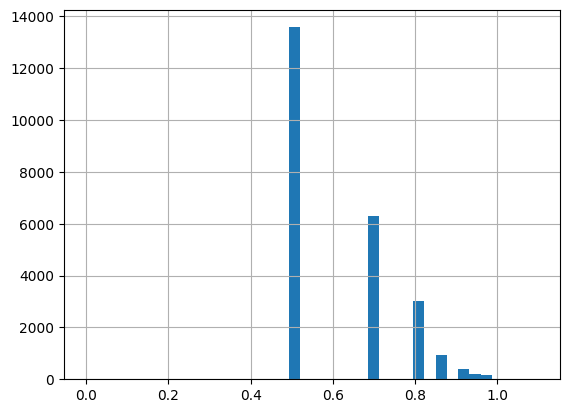

In [112]:
pl = tf.Plotter(dft.df)
pl.col_hist('inq_last_6mths')
pl.box_and_whisker('inq_last_6mths')

In [113]:
#Quick look at pre-transform graph:

px.box(dt.df,y='inq_last_6mths')

<Axes: >

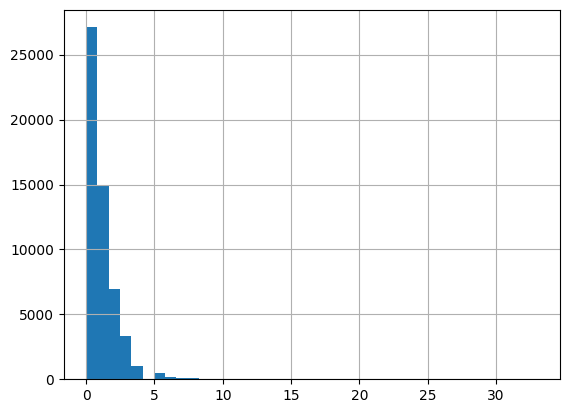

In [114]:
dt.df['inq_last_6mths'].hist(bins=40)

In [115]:
# remove outliers

dft.remove_outliers(df_outliers)
print(len(dft.df))

49208


Outliers open_accounts

In [116]:
col = 'open_accounts'
dft_z = dft_z.calc_z_scores(col)
mask = dft_z.df[col + '_z'].abs() > 3
print(dft_z.df[mask][col + '_z'].sort_values())

54089   -3.424933
32070   -3.424933
5984    -3.424933
17804   -3.424933
52984   -3.424933
           ...   
53284    4.153537
53669    4.222992
2586     4.291317
18474    4.489900
18992    4.617325
Name: open_accounts_z, Length: 125, dtype: float64


In [117]:
df_outliers = dft.calc_outliers_IQR(col)
print(df_outliers[col].value_counts())

open_accounts
4.981661    36
0.746600    31
5.049275    28
5.115191    26
5.303652    15
5.179504    15
5.242298    13
5.591197     6
5.363640     5
5.698306     5
5.422329     4
5.536052     4
5.801467     4
5.750360     3
5.479780     2
5.645267     1
6.044077     1
6.180411     1
6.267893     1
5.949486     1
5.997170     1
Name: count, dtype: int64


0.003309859166994113


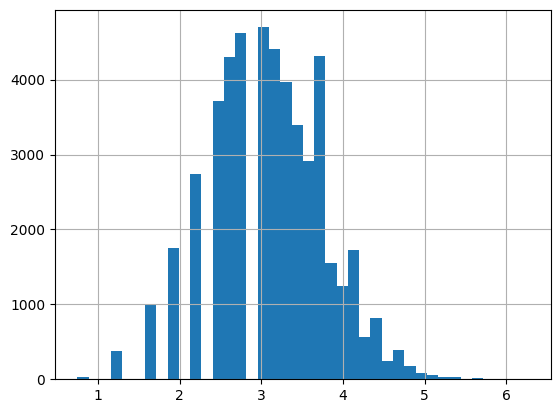

In [118]:
pl = tf.Plotter(dft.df)
pl.col_hist('open_accounts')
pl.box_and_whisker('open_accounts')

In [119]:
# remove outliers

dft.remove_outliers(df_outliers)
print(len(dft.df))

49005


Outliers total_accounts

In [120]:
col = 'total_accounts'
dft_z = dft_z.calc_z_scores(col)
mask = dft_z.df[col + '_z'].abs() > 3
print(dft_z.df[mask][col + '_z'].sort_values())

54139    3.006714
24827    3.006714
25896    3.006714
26068    3.006714
27339    3.006714
           ...   
922      5.510977
3373     5.597331
48016    5.683684
4199     6.288162
4031     7.238054
Name: total_accounts_z, Length: 552, dtype: float64


In [121]:
df_outliers = dft.calc_outliers_IQR(col)
print(df_outliers[col].value_counts())

total_accounts
63.0    155
58.0     74
61.0     67
62.0     65
59.0     64
56.0     63
57.0     59
60.0     48
64.0      8
67.0      7
69.0      5
65.0      5
73.0      4
80.0      4
74.0      4
75.0      3
76.0      2
81.0      2
68.0      2
78.0      2
70.0      2
71.0      2
82.0      1
89.0      1
66.0      1
84.0      1
72.0      1
90.0      1
Name: count, dtype: int64


0.79468256823603


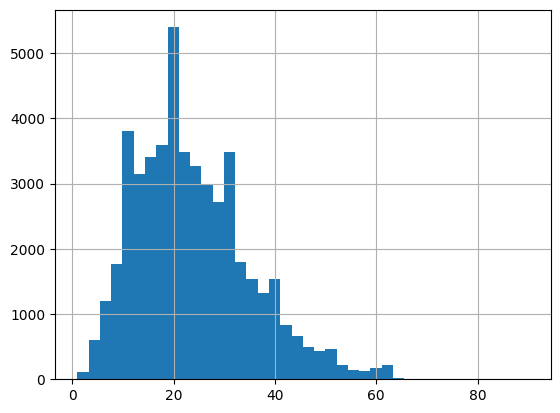

In [122]:
pl = tf.Plotter(dft.df)
pl.col_hist('total_accounts')
pl.box_and_whisker('total_accounts')

In [123]:
# remove outliers

dft.remove_outliers(df_outliers)
print(len(dft.df))

48352


Outliers out_prncp

In [124]:
col = 'out_prncp'
dft_z = dft_z.calc_z_scores(col)
mask = dft_z.df[col + '_z'].abs() > 3
print(dft_z.df[mask][col + '_z'].sort_values())

Series([], Name: out_prncp_z, dtype: float64)


In [125]:
df_outliers = dft.calc_outliers_IQR(col)
print(df_outliers[col].value_counts())

out_prncp
5.766350    1
5.081777    1
4.514479    1
5.683988    1
5.989513    1
           ..
5.046260    1
5.555089    1
0.751416    1
5.785240    1
5.253581    1
Name: count, Length: 219, dtype: int64


-0.733313487349515


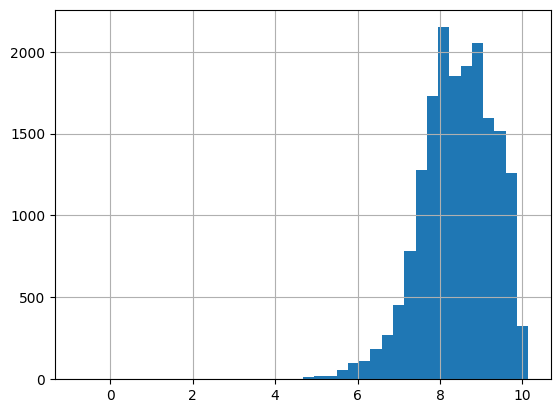

In [126]:
pl = tf.Plotter(dft.df)
pl.col_hist('out_prncp')
pl.box_and_whisker('out_prncp')

In [127]:
# remove outliers

dft.remove_outliers(df_outliers)
print(len(dft.df))

48133


Outliers out_prncp_inv

In [128]:
col = 'out_prncp_inv'
dft_z = dft_z.calc_z_scores(col)
mask = dft_z.df[col + '_z'].abs() > 3
print(dft_z.df[mask][col + '_z'].sort_values())

Series([], Name: out_prncp_inv_z, dtype: float64)


In [129]:
df_outliers = dft.calc_outliers_IQR(col)
print(df_outliers[col].value_counts())

out_prncp_inv
3.627188    2
3.616476    2
3.698012    1
3.616671    1
3.510576    1
           ..
3.540404    1
3.669775    1
3.614374    1
3.729448    1
3.348345    1
Name: count, Length: 358, dtype: int64


-2.486030329067703


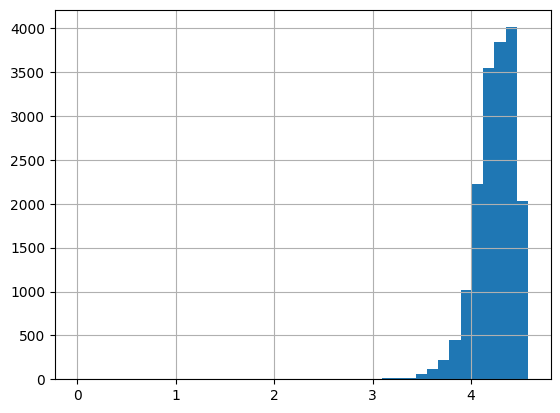

In [130]:
pl = tf.Plotter(dft.df)
pl.col_hist(col)
pl.box_and_whisker(col)

Outliers total_payment

In [131]:
col = 'total_payment'
dft_z = dft_z.calc_z_scores(col)
mask = dft_z.df[col + '_z'].abs() > 3
df_z_outliers = dft_z.df[mask]
print(dft_z.df[mask][col + '_z'].sort_values())

51259   -3.730320
18277   -3.540195
47243   -3.493054
33546   -3.445755
37975   -3.425643
50716   -3.405627
4857    -3.392284
37364   -3.372914
40721   -3.333650
40906   -3.322974
38751   -3.320105
37605   -3.307810
34456   -3.264099
2752    -3.253844
37822   -3.244587
39276   -3.237718
47982   -3.236695
52999   -3.232138
35216   -3.230763
12101   -3.228024
53834   -3.224797
22923   -3.207726
53714   -3.204518
44289   -3.200666
22559   -3.193893
50886   -3.181441
37312   -3.160640
34530   -3.144518
48619   -3.133513
8980    -3.125357
40539   -3.109953
39802   -3.091782
52973   -3.085986
47927   -3.075759
35410   -3.071344
39406   -3.051057
37446   -3.050484
31928   -3.046542
47619   -3.045227
23252   -3.042358
33735   -3.040470
33795   -3.034367
51705   -3.010929
7323    -3.005628
35503   -3.003276
1852    -3.000517
36036    3.003450
40206    3.019544
Name: total_payment_z, dtype: float64


In [132]:
df_outliers = dft.calc_outliers_IQR(col)
print(df_outliers[col].value_counts())

total_payment
16.820229    2
17.057929    2
80.853915    1
81.684372    1
80.953717    1
            ..
83.011963    1
13.867103    1
15.555541    1
14.648433    1
12.338442    1
Name: count, Length: 159, dtype: int64


-0.01766454697932157


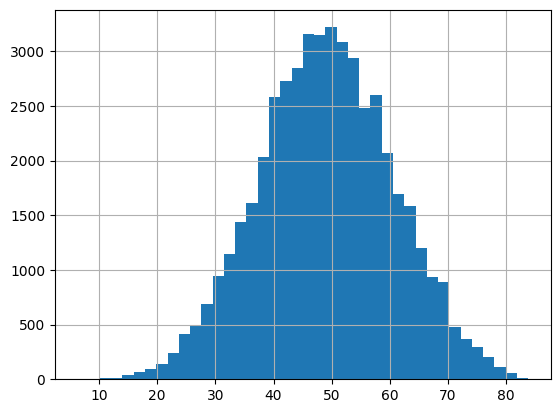

In [133]:
pl = tf.Plotter(dft.df)
pl.col_hist(col)
pl.box_and_whisker(col)

In [134]:
# remove outliers

dft.remove_outliers(df_z_outliers)
print(len(dft.df))

48127


Outliers total_payment_inv

In [135]:
col = 'total_payment_inv'
dft_z = dft_z.calc_z_scores(col)
mask = dft_z.df[col + '_z'].abs() > 3
df_z_outliers = dft_z.df[mask]
print(dft_z.df[mask][col + '_z'].sort_values())

53046   -3.408038
53107   -3.408038
53105   -3.408038
53103   -3.408038
53099   -3.408038
           ...   
42875    3.075111
41837    3.087057
36339    3.087473
35298    3.094803
38390    3.139291
Name: total_payment_inv_z, Length: 155, dtype: float64


In [136]:
df_outliers = dft.calc_outliers_IQR(col)
print(df_outliers[col].value_counts())

total_payment_inv
145.614399    1
16.308757     1
9.148021      1
16.664665     1
8.672627      1
             ..
152.417835    1
147.004780    1
148.650222    1
149.524370    1
14.183335     1
Name: count, Length: 166, dtype: int64


0.08810546752847576


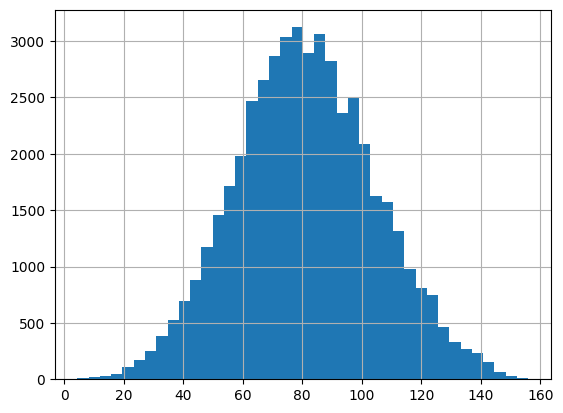

In [137]:
pl = tf.Plotter(dft.df)
pl.col_hist(col)
pl.box_and_whisker(col)

In [138]:
# remove outliers

dft.remove_outliers(df_outliers)
print(len(dft.df))

47961


Outliers total_rec_prncp 

In [139]:
col = 'total_rec_prncp'
dft_z = dft_z.calc_z_scores(col)
mask = dft_z.df[col + '_z'].abs() > 3
df_z_outliers = dft_z.df[mask]
print(dft_z.df[mask][col + '_z'].sort_values())

49128   -3.831380
18277   -3.412488
47243   -3.409452
33546   -3.406627
51259   -3.404278
37975   -3.383652
50716   -3.340755
40721   -3.306942
28126   -3.244388
44170   -3.232216
38751   -3.229557
38055   -3.194623
37364   -3.172075
40906   -3.170534
43881   -3.157601
4857    -3.149730
47982   -3.125661
27647   -3.124825
6166    -3.120750
35216   -3.120212
14108   -3.096522
22691   -3.089992
40963   -3.087031
30465   -3.086188
48015   -3.079543
44289   -3.078076
34530   -3.073738
37822   -3.063255
22559   -3.043712
37605   -3.042564
53834   -3.040205
22171   -3.032621
33735   -3.020092
2752    -3.016558
34456   -3.016097
7323    -3.015440
38762   -3.012919
24873   -3.005466
47927   -3.005112
27072   -3.001654
Name: total_rec_prncp_z, dtype: float64


In [140]:
df_outliers = dft.calc_outliers_IQR(col)
print(df_outliers[col].value_counts())

total_rec_prncp
13.678635    2
13.381614    1
13.954961    1
10.803318    1
12.399791    1
            ..
7.334051     1
12.726968    1
13.026135    1
10.366837    1
14.434443    1
Name: count, Length: 129, dtype: int64


-0.021163771650618002


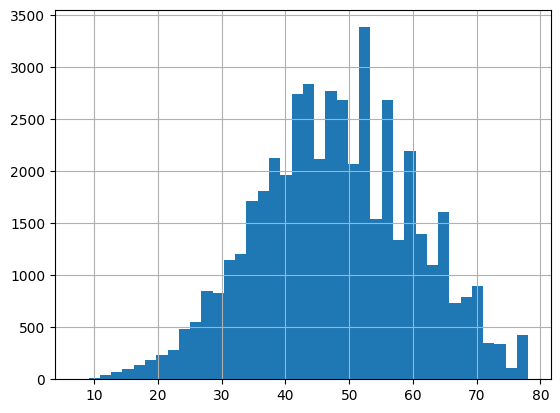

In [141]:
pl = tf.Plotter(dft.df)
pl.col_hist(col)
pl.box_and_whisker(col)

In [142]:
# remove outliers

dft.remove_outliers(df_outliers)
print(len(dft.df))

47831


Outliers total_rec_int  

In [143]:
col = 'total_rec_int'
dft_z = dft_z.calc_z_scores(col)
mask = dft_z.df[col + '_z'].abs() > 3
df_z_outliers = dft_z.df[mask]
print(dft_z.df[mask][col + '_z'].sort_values())

49893   -3.659949
49859   -3.657109
1931    -3.624247
50027   -3.607058
50531   -3.564843
           ...   
42875    3.057793
40300    3.084408
34512    3.117379
34931    3.117451
38972    3.190374
Name: total_rec_int_z, Length: 102, dtype: float64


In [144]:
df_outliers = dft.calc_outliers_IQR(col)
print(df_outliers[col].value_counts())

total_rec_int
5.386750     2
4.452822     2
3.934492     2
23.590243    2
5.173512     2
            ..
3.967798     1
23.880054    1
5.313761     1
4.836765     1
5.640072     1
Name: count, Length: 319, dtype: int64


0.008147715250523333


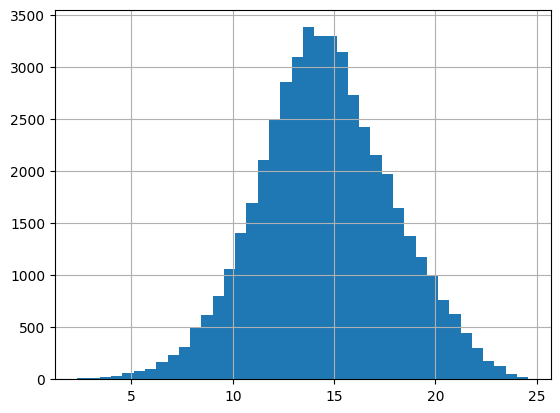

In [145]:
pl = tf.Plotter(dft.df)
pl.col_hist(col)
pl.box_and_whisker(col)

In [146]:
# remove outliers

dft.remove_outliers(df_outliers)
print(len(dft.df))

47501


Outliers total_rec_late_fee

In [147]:
col = 'total_rec_late_fee'
dft_z = dft_z.calc_z_scores(col)
mask = dft_z.df[col + '_z'].abs() > 3
df_z_outliers = dft_z.df[mask]
print(dft_z.df[mask][col + '_z'].sort_values())

11026     3.007153
4996      3.023719
42578     3.024735
11741     3.028558
51653     3.031903
           ...    
8346     23.279821
48333    26.704727
29590    28.700377
20089    36.919941
21963    57.719713
Name: total_rec_late_fee_z, Length: 857, dtype: float64


In [148]:
df_outliers = dft.calc_outliers_IQR(col)
print(df_outliers[col].value_counts())

total_rec_late_fee
81.900000    1
86.097715    1
80.781132    1
56.106165    1
82.697087    1
            ..
56.605870    1
68.855741    1
70.123089    1
80.492582    1
87.040536    1
Name: count, Length: 111, dtype: int64


3.3268843242541517


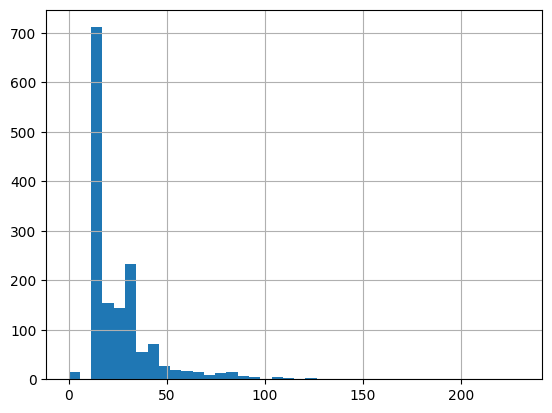

In [149]:
pl = tf.Plotter(dft.df)
pl.col_hist(col)
pl.box_and_whisker(col)

In [150]:
# remove outliers

dft.remove_outliers(df_outliers)
print(len(dft.df))

47390


End of outliers

### CORRELATION MATRIX 

In [151]:
# Update plotter and DataFrameInfo classes with DataFrame with outliers removed

pl = tf.Plotter(dft.df)
dfi = tf.DataFrameInfo(dft.df)

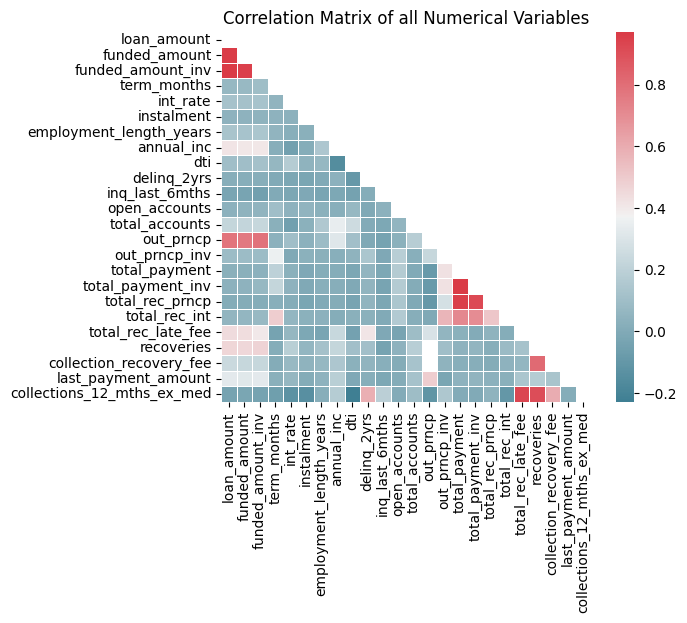

funded_amount        0.962162
funded_amount_inv    0.969539
Name: loan_amount, dtype: float64
loan_amount          0.962162
funded_amount_inv    0.948366
Name: funded_amount, dtype: float64
loan_amount      0.969539
funded_amount    0.948366
Name: funded_amount_inv, dtype: float64
Series([], Name: term_months, dtype: float64)
Series([], Name: int_rate, dtype: float64)
Series([], Name: instalment, dtype: float64)
Series([], Name: employment_length_years, dtype: float64)
Series([], Name: annual_inc, dtype: float64)
Series([], Name: dti, dtype: float64)
Series([], Name: delinq_2yrs, dtype: float64)
Series([], Name: inq_last_6mths, dtype: float64)
Series([], Name: open_accounts, dtype: float64)
Series([], Name: total_accounts, dtype: float64)
Series([], Name: out_prncp, dtype: float64)
Series([], Name: out_prncp_inv, dtype: float64)
total_payment_inv    0.970612
total_rec_prncp      0.954630
Name: total_payment, dtype: float64
total_payment      0.970612
total_rec_prncp    0.922992
Name: t

In [152]:
num_cols = dft.df.select_dtypes(include=[np.number]).columns.drop('id')
corr_df = pl.correlation_matrix(num_cols)


for col in num_cols:
    print(corr_df[col][(corr_df[col]>0.9) & (corr_df[col] < 1.0)])



So could potentially drop two in each group of three / one in each group of two from:

funded_amount        0.962162
funded_amount_inv    0.969539
Name: loan_amount, dtype: float64

loan_amount          0.962162
funded_amount_inv    0.948366
Name: funded_amount, dtype: float64

loan_amount      0.969539
funded_amount    0.948366
Name: funded_amount_inv, dtype: float64

---

total_payment_inv    0.970612
total_rec_prncp      0.954630
Name: total_payment, dtype: float64

total_payment      0.970612
total_rec_prncp    0.922992
Name: total_payment_inv, dtype: float64

total_payment        0.954630
total_payment_inv    0.922992
Name: total_rec_prncp, dtype: float64

---

collections_12_mths_ex_med    0.930481
Name: total_rec_late_fee, dtype: float64

collections_12_mths_ex_med    0.908866
Name: recoveries, dtype: float64

total_rec_late_fee    0.930481
recoveries            0.908866
Name: collections_12_mths_ex_med, dtype: float64

In [153]:
print(dft.df['collections_12_mths_ex_med'].count())
print(dft.df['total_rec_late_fee'].count())

#So drop collections_12_mths_ex_med

dft.df = dft.df.drop(["collections_12_mths_ex_med"], axis=1)

176
1413


In [154]:
print(dft.df['total_payment_inv'].count())
print(dft.df['total_payment'].count())

# So drop total_payment_inv

dft.df = dft.df.drop(["total_payment_inv"], axis=1)


47175
47286


In [155]:
print(dft.df['total_rec_prncp'].count())
print(dft.df['total_payment'].count())

# So drop total_payment_inv

dft.df = dft.df.drop(["total_rec_prncp"], axis=1)


47285
47286


In [156]:
print(dft.df['funded_amount_inv'].count())
print(dft.df['funded_amount'].count())

# So drop funded_amount_inv

dft.df = dft.df.drop(["funded_amount_inv"], axis=1)


47262
47353


In [157]:
print(dft.df['loan_amount'].count())
print(dft.df['funded_amount'].count())

# So drop funded_amount

dft.df = dft.df.drop(["funded_amount"], axis=1)


47353
47353


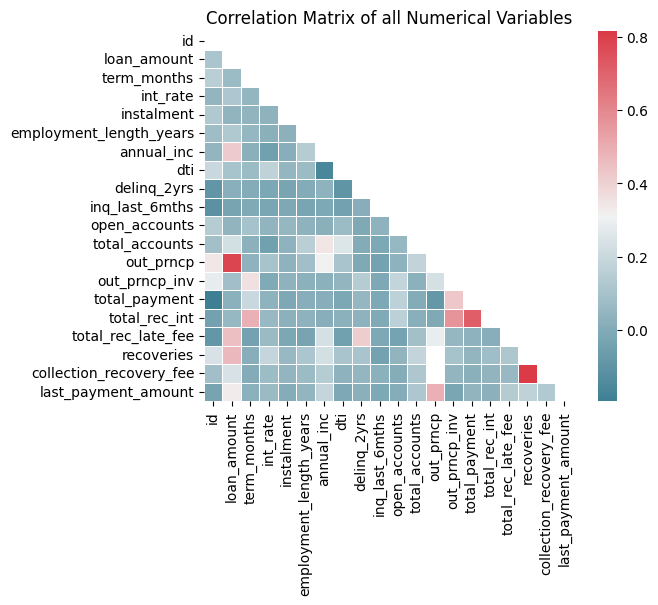

In [158]:
pl = tf.Plotter(dft.df)
num_cols = dft.df.select_dtypes(include=[np.number]).columns.tolist()
corr_df = pl.correlation_matrix(num_cols)

In [159]:
# The following hasn't worked - need to look into - but not required currently as data from correlation matrix used to decide on dropping correlated columns.

dft.variation_inflation_factor()

loan_amount 1.0 0


,loan_amount,term_months,int_rate,instalment,employment_length_years,annual_inc,dti,delinq_2yrs,inq_last_6mths,open_accounts,total_accounts,out_prncp,out_prncp_inv,total_payment,total_rec_int,total_rec_late_fee,recoveries,collection_recovery_fee,last_payment_amount
